Summary: Takes a random pair of a Parasite and a Single Host signals. Finds the 11.5-28Hz amplitude envelope modulation component and replaces it (or adds on top of it) the equivalent component of the other member of the pair. 
Creates and saves modified signals as wav files. Two control versions of the original signals are also created: remove and reintroduce own component for both files.

Author: E.R.

Last modified: Tuesday 27/10/2022 14:27

version: 1

# Set up environment 

In [1]:
import os
if not os.path.isdir('/content/amplitude-modulation-analysis-module'):
  !git clone https://github.com/MuSAELab/amplitude-modulation-analysis-module.git


try:
  import am_analysis
except ModuleNotFoundError:
  !pip install /content/amplitude-modulation-analysis-module  


Cloning into 'amplitude-modulation-analysis-module'...
remote: Enumerating objects: 143, done.
remote: Counting objects: 100% (3/3), done.
remote: Compressing objects: 100% (3/3), done.
remote: Total 143 (delta 0), reused 1 (delta 0), pack-reused 140
Receiving objects: 100% (143/143), 785.74 KiB | 19.64 MiB/s, done.
Resolving deltas: 100% (69/69), done.
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Processing ./amplitude-modulation-analysis-module
  DEPRECATION: A future pip version will change local packages to be built in-place without first copying to a temporary directory. We recommend you use --use-feature=in-tree-build to test your packages with this new behavior before it becomes the default.
   pip 21.3 will remove support for this functionality. You can find discussion regarding this at https://github.com/pypa/pip/issues/7555.
  Created wheel for am-analysis: filename=am_analysis-0.1-py3-none-any.whl size=20028 sha256=75e617

In [2]:
import numpy as np
import matplotlib.pyplot as plt
import scipy
from scipy.signal import hilbert, butter, lfilter, freqz
from scipy import signal as sig
import pandas as pd
from IPython.display import Audio
import librosa
import librosa.display
import IPython.display as ipd
import soundfile as sf

import random

from am_analysis import am_analysis as ama

# User-defined Parameters

In [ ]:
# CHOOSE LIMITS OF THE BANDSTOP FILTER (in Hz). THIS IS THE AMPLITUDE MODULATION BAND TO BE REMOVED FROM THE AMPLITUDE ENVELOPES OF THE SIGNALS
low_bs_f = 11.5
high_bs_f = 28


In [ ]:
# USE FULL 15s AUDIO FILES OR SMALLER CLIPS 
# 1 = use full audio
# 0 = use small clips

use_full = 1

In [ ]:
# IF NOT USING THE FULL 15s AUDIOWAVES, CHOOSE WHERE EACH SIGNAL SHOULD START AND ALSO THE DURATION OF THE CLIP
# NUMBERS REPRESENT SECONDS (from 0 to 15)
# SIGNAL_START + SIGNAL DURATION CAN NOT BE > 15

# for the parasite call
signal_start_P1 = 6
signal_duration_P1 = 3

# for the single host call
signal_start_SH1 = 10
signal_duration_SH1 = 3

In [ ]:
# Toggle on/off for displaying plots and listening to audio within the notebook
show_plots = 1 # should plots be shown for all parts of the signal processing?  1 = YES, 0 = NO

In [ ]:
# Frequency range for bank-filtering of signals
# Need to choose: minimum frequency, maximum frequncy, and number of bank-filters
# The maximum frequency can not be higher than half the sampling rate (in our case sr = 22050Hz, so the maximum frequncy should be <11025)

min_bank_f = 2
max_bank_f = 10312 #(empirically chosen. Above this there is practically no power in the audios)
n_bank = 16

freqs = np.linspace(min_bank_f,max_bank_f,n_bank+1)

print('the frequency intervals are: \n',freqs)

the frequency intervals are: 
 [2.000000e+00 6.463750e+02 1.290750e+03 1.935125e+03 2.579500e+03
 3.223875e+03 3.868250e+03 4.512625e+03 5.157000e+03 5.801375e+03
 6.445750e+03 7.090125e+03 7.734500e+03 8.378875e+03 9.023250e+03
 9.667625e+03 1.031200e+04]


# Get Data

mount google drive and unzip (locally on colab) directory with relevant files

In [ ]:
if not os.path.isdir('/content/drive/MyDrive/15s_recordings'):
  !unzip '/content/drive/MyDrive/15s_recordings.zip'

# Read in and examine audiowaves

choose randomly a parasite 1 file and a single host 1 file

**choose a file for parasite 1 (audiofile_P1)**

In [ ]:
audiofile_P1 = '/content/15s_recordings/parasite1_single/' + random.choice(os.listdir('/content/15s_recordings/parasite1_single'))

In [ ]:
name_P = os.path.basename(audiofile_P1).split('.')[0]
print('Parasite file chosen:',name_P)

Parasite file chosen: LT059_18_1IM_15s


**choose a file for brood host 1 (audiofile_BH1)**

In [ ]:
audiofile_SH1 = '/content/15s_recordings/host_1_single/' + random.choice(os.listdir('/content/15s_recordings/host_1_single')) 

In [ ]:
name_SH = os.path.basename(audiofile_SH1).split('.')[0]
print('Single Host file chosen:',name_SH)

Single Host file chosen: LT048_18_1LT_15s


**Plot the full audiowaves (named `signal_full_P1` and `signal_full_SH1`)**

total audio duration of file /content/15s_recordings/parasite1_single/LT059_18_1IM_15s.wav is : 15.01s


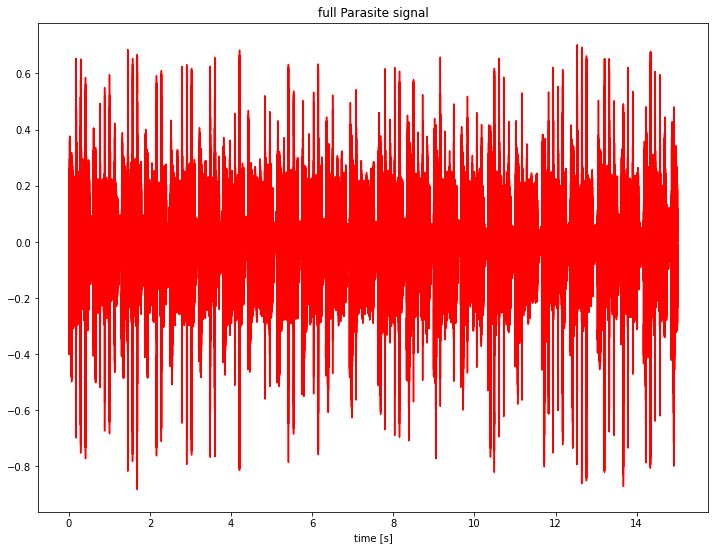

In [ ]:
signal_full_P1, sr = librosa.load(audiofile_P1)
print(f'total audio duration of file {audiofile_P1} is : {len(signal_full_P1)/sr:.2f}s')


if show_plots:

  t = np.linspace(0,len(signal_full_P1)/sr, len(signal_full_P1))
  plt.figure(figsize=(12,9))  
  plt.plot(t, signal_full_P1,c='r')
  plt.xlabel('time [s]')
  plt.title('full Parasite signal')
  plt.plot()

In [ ]:

print('PARASITE FULL DURATION AUDIO')
Audio(data=signal_full_P1,rate=sr)


PARASITE FULL DURATION AUDIO


total audio duration of file /content/15s_recordings/host_1_single/LT048_18_1LT_15s.wav is : 15.03s


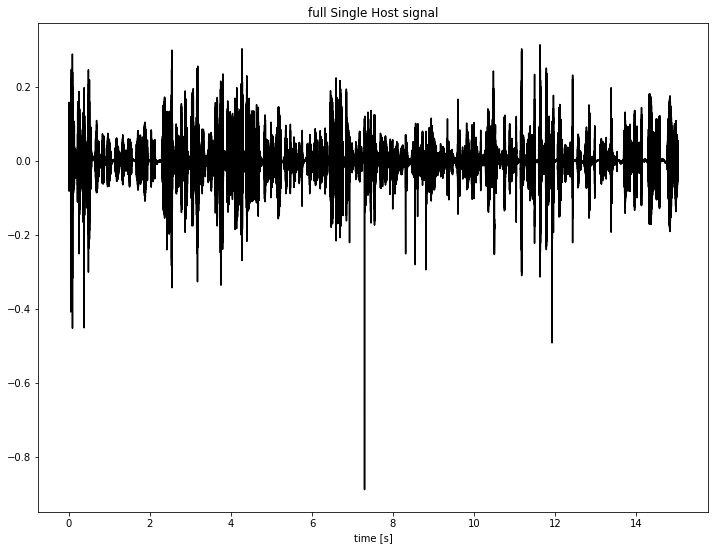

In [ ]:
signal_full_SH1, sr = librosa.load(audiofile_SH1)
print(f'total audio duration of file {audiofile_SH1} is : {len(signal_full_SH1)/sr:.2f}s')


if show_plots:
  t = np.linspace(0,len(signal_full_SH1)/sr, len(signal_full_SH1))
  plt.figure(figsize=(12,9))
  plt.plot(t, signal_full_SH1,c='k')
  plt.xlabel('time [s]')
  plt.title('full Single Host signal')
  plt.plot()



In [ ]:

print('SINGLE HOST FULL DURATION AUDIO')
Audio(data=signal_full_SH1,rate=sr)   


SINGLE HOST FULL DURATION AUDIO


**Plot the parts of the audios to be used (named `signalP1` and `signalSH1`)**

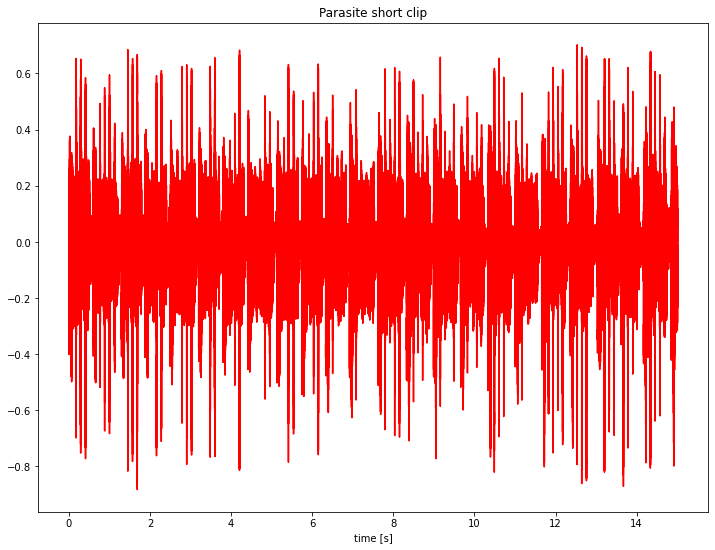

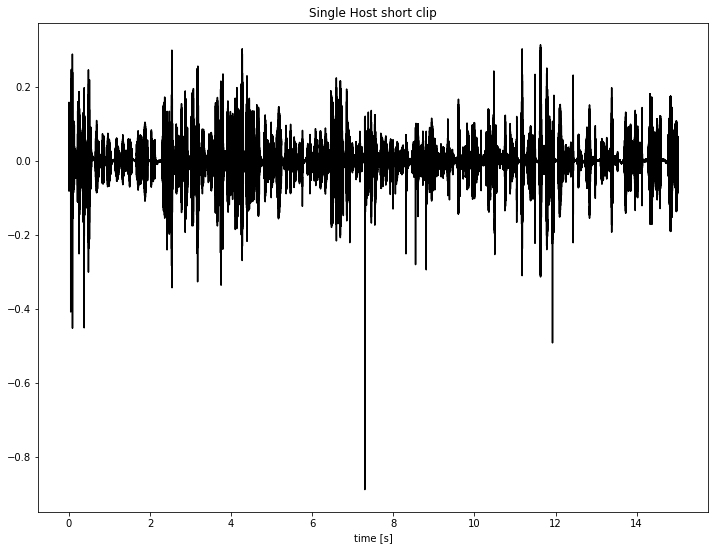

In [ ]:
if not use_full:
  signalP1 = signal_full_P1[signal_start_P1*sr:(signal_start_P1 + signal_duration_P1)*sr]  
  signalSH1 = signal_full_SH1[signal_start_SH1*sr:(signal_start_SH1 + signal_duration_SH1)*sr]
  
else:  
  signal_duration_P1 = min(len(signal_full_P1),len(signal_full_SH1))/sr
  signal_duration_SH1 = min(len(signal_full_P1),len(signal_full_SH1))/sr
  signalP1 = signal_full_P1[0:min(len(signal_full_P1),len(signal_full_SH1))]
  signalSH1 = signal_full_SH1[0:min(len(signal_full_P1),len(signal_full_SH1))]
  signal_start_P1 = 0
  signal_start_SH1 = 0


if show_plots:    

  tP1 = np.linspace(signal_start_P1,signal_start_P1+signal_duration_P1, len(signalP1))
  plt.figure(figsize=(12,9))
  plt.plot(tP1, signalP1,c='r')
  plt.xlabel('time [s]')
  plt.title('Parasite short clip')
  plt.plot()



  tSH1 = np.linspace(signal_start_SH1,signal_start_SH1+signal_duration_SH1, len(signalSH1))
  plt.figure(figsize=(12,9))
  plt.plot(tSH1, signalSH1,c='k')
  plt.xlabel('time [s]')
  plt.title('Single Host short clip')
  plt.plot()


In [ ]:

print('PARADISE AUDIO CLIP TO USE')

Audio(data=signalP1,rate=sr)  

PARADISE AUDIO CLIP TO USE


In [ ]:


print('SINGLE HOST AUDIO CLIP TO USE')

Audio(data=signalSH1,rate=sr)

SINGLE HOST AUDIO CLIP TO USE


# Build some filters 

## Bandpass (Butterworth) filter

In [ ]:

def butter_bandpass(lowcut, highcut, fs, order=2):
    nyq = 0.5 * fs
    low = lowcut / nyq
    high = highcut / nyq
    b, a = butter(order, [low, high], btype='bandpass')
    return b, a


def butter_bandpass_filter(data, lowcut, highcut, fs, order=6):
    b, a = butter_bandpass(lowcut, highcut, fs, order=order)
    #y = lfilter(b, a, data)
    y = sig.filtfilt(b, a, data, method='gust')

    return y



## another bandpass filter using *FIR*

In [ ]:

def bandpass(input, fs, fpl, fph, bandwidth, ripple_db=65.0):
        """
        Designs a FIR filter that is a bandpass filter.
        fs : sampling frequency (Hz)
        fpl : low pass frequency (Hz)
        fph : high pass frequency (Hz)
        bandwidth : transition bandwidth (Hz)s
        """
        # Compute the order and Kaiser parameter for the FIR filter.
        N, beta = sig.kaiserord(ripple_db, bandwidth / (fs * 0.5) )

        # Use firwin with a Kaiser window to create a lowpass FIR filter.
        taps = sig.firwin(N, [fpl / (fs * 0.5), fph / (fs * 0.5)], window=('kaiser', beta),pass_zero='bandpass')

        # the filter must be symmetric, in order to be zero-phase
        assert np.all(np.abs(taps - taps[::-1]) < 1e-15)

        input_filt = sig.filtfilt(taps, 1, input, method = 'pad', padtype = 'constant')

        return input_filt

## lowpass filter

In [ ]:
def lowpass(input, fs, fc, bandwidth, ripple_db=65.0):
        """
        Designs a FIR filter that is a low-pass filter.
        fs : sampling frequency (Hz)
        fc : cut-off frequency (Hz)
        bandwidth : transition bandwidth (Hz)s
        """
        # Compute the order and Kaiser parameter for the FIR filter.
        N, beta = sig.kaiserord(ripple_db, bandwidth / (fs * 0.5) )

        # Use firwin with a Kaiser window to create a lowpass FIR filter.
        taps = sig.firwin(N, fc / (fs * 0.5), window=('kaiser', beta))

        # the filter must be symmetric, in order to be zero-phase
        assert np.all(np.abs(taps - taps[::-1]) < 1e-15)

        input_filt = sig.filtfilt(taps, 1, input, method = 'pad', padtype = 'constant')

        return input_filt

## bandstop (notch) filter

In [ ]:
def bandstop(input,fs, fstop, quality_factor=1.2):
    """
    Designs a IIR bandstop filter.
    fs : sampling frequency (Hz)
    fstop : frequency to remove (Hz)
    quality_factor : dimensionless parameter that characterises quality
    """
    b_notch, a_notch = sig.iirnotch(fstop, quality_factor, fs)
    input_notched = sig.filtfilt(b_notch, a_notch, input)
    w,h = sig.freqz(b_notch, a_notch, worN=16384)
    return input_notched, w, h


## Bandstop (Butterworth) filter


In [ ]:


#def butter_bandstop(lowcut, highcut, fs, order=3):
#    nyq = 0.5 * fs
#    low = lowcut / nyq
#    high = highcut / nyq
#    b, a = butter(order, [low, high], btype='bandstop')
#    return b, a


def butter_bandstop_filter(data, lowcut, highcut, fs, order=3):
    nyq = 0.5 * fs
    low = lowcut / nyq
    high = highcut / nyq
    b, a = butter(order, [low, high], btype='bandstop')
    #b, a = butter_bandstop(lowcut, highcut, fs, order=order)

    z, p, k = sig.tf2zpk(b, a)
    eps = 1e-9
    r = np.max(np.abs(p))
    approx_impulse_len = int(np.ceil(np.log(eps) / np.log(r)))


    y = sig.filtfilt(b, a, data, method='gust',irlen=approx_impulse_len)

    w,h = sig.freqz(b, a, worN=16384)
    f=(fs/2)*w/(np.pi)  
    return y, f , h

# Useful Functions

In [ ]:
def apply_bank_filters(signal, sr, freqs, plots=1, bandwidth = 10, ripple_db = 50):


# apply bank-filters to the original parasite signal to create narrowband signals.

# timepoints for the plots
  t = np.linspace(0,len(signal)/sr, len(signal), endpoint=False)


  bp_signal = []
  for i in range(len(freqs)-1):
    lowcut = freqs[i]
    highcut = freqs[i+1]

    bp_signal.append(bandpass(signal, sr, lowcut, highcut, bandwidth=10,ripple_db=50))
    if plots:
      plt.figure(figsize=(10,7))
      plt.clf()
      plt.plot(t, signal, label='Original full signal')
      plt.plot(t, bp_signal[i], label='Original narrowband signal' )
      plt.xlabel('time (seconds)')
      plt.grid(True)
      plt.axis('tight')
      #plt.ylim([-1,1])
      plt.legend(loc='upper left')
      plt.title(str(round(lowcut,1))+' - '+str(round(highcut,1))+' Hz')
      plt.show()
  return bp_signal  

In [ ]:
def get_AE(signal, sr, freqs, plots=1):

# For each of the original narrowband signals get the A.E. using Hilbert transform

  amp_env = []
  inst_phase_o = []
  f_i=0

  for s in signal:
    t = np.linspace(0,len(s)/sr, len(s), endpoint=False)
    lowcut = freqs[f_i]
    highcut = freqs[f_i+1]
    z = (hilbert(s)) #form the analytical signal
    amp_env.append(np.abs(z)) #envelope extraction
    inst_phase_o.append(np.unwrap(np.angle(z)))#inst phase
    inst_freq = np.diff(inst_phase_o)/(2*np.pi)*sr #inst frequency

    if plots:
      plt.figure(figsize=(10,7))
      plt.plot(t,s)
      plt.plot(t,amp_env[-1])
      #plt.ylim([-0.5,0.5])
      plt.xlabel('time [s]')
      plt.ylabel('Amplitude')
      plt.title(str(round(lowcut,1))+' - '+str(round(highcut,1))+' Hz')
      plt.show()
    f_i+=1
  return amp_env    

In [ ]:

def mod_amp_filter(amp_env, sr, low_cutoff, high_cutoff, order = 2, plots = 1, plot_response = 1):

  amp_env_filtered=[]
  for ae in amp_env:
    y , f ,h = butter_bandstop_filter(ae, low_cutoff, high_cutoff, sr, order=2)
    amp_env_filtered.append(y)
    if plots:
      t = np.linspace(0,len(ae)/sr, len(ae), endpoint=False)
      plt.figure(figsize=(12,9))
      plt.plot(t,ae, label='original AE')
      plt.plot(t,amp_env_filtered[-1], label='bandstop-filtered AE')
      plt.legend()
      plt.xlabel('time [s]')
      plt.show()
  if plots and plot_response:
    plt.figure(figsize=(12,9))
    plt.plot(f,abs(h))
    #plt.plot(f,20*np.log10(abs(h)))
    plt.plot([low_cutoff,low_cutoff],[0,1])
    plt.plot([high_cutoff,high_cutoff],[0,1])
    #plt.xlim([1050,1150])
    plt.xlabel('Frequency [Hz]')
    #plt.ylabel('Amplitude [dB]')
    plt.xscale('log')
    plt.title('Bandstop filter frequency response')
    plt.show()
  return amp_env_filtered

In [ ]:
# define a function that does half-wave rectification
def half_rectify(amp_env, sr, plots = 1):
  '''
#  Half rectifies a signal: set all negative values to zero
#  input: a signal in the form of a list/array
#  output: rectified signal
#  '''
  amp_env_rect = []

  for ae in amp_env:
    amp_env_rect.append(np.asarray([0 if i<0 else i for i in ae]))

  if plots:
    for i in range(len(amp_env)):
      t = np.linspace(0,len(amp_env[i])/sr, len(amp_env[i]), endpoint=False)
      plt.figure(figsize=(12,9))
      plt.plot(t,amp_env[i],label='bandstop-filtered AE')
      plt.plot(t,amp_env_rect[i],label='rectified bandstop-filtered AE')
      plt.xlabel('time [s]')
      plt.legend()
      plt.show()

  return amp_env_rect

In [ ]:
def sig_removed(amp_env, amp_env_filtered, plots = 1):

# this is the difference (in the time-amplitude domain) between the original narrowband AEs and the filtered narrowband AEs 
# (i.e. AE with specific modulation frequencies removed).

  sig_removed = np.subtract(amp_env, amp_env_filtered)

  if plots:
    for i in range(len(sig_removed)):
      plt.figure(figsize=(10,7))
      plt.plot(amp_env[i],label='orig. AE')
      plt.plot(sig_removed[i],label='orig. AE - mod. AE ')
      plt.legend()
      plt.show()
  return sig_removed

In [ ]:
def implant(amp_env_recipient, extracted_donor_signal):

#implant an extracted signal from the AEs of one signal (donor) into the AEs of another signal (recipient)

  if len(amp_env_recipient) != len(extracted_donor_signal):
    print('the recipient and donor signals should be of the same length')
    return

  modified_amp_env = []

  for i in range(len(amp_env_recipient)):
    modified_amp_env.append(amp_env_recipient[i] + extracted_donor_signal[i])

  return modified_amp_env

# **Modulation filtering** *(remove AE frequencies from Parasite and Single Host)*

## Filter-bank original signals

### Parasite

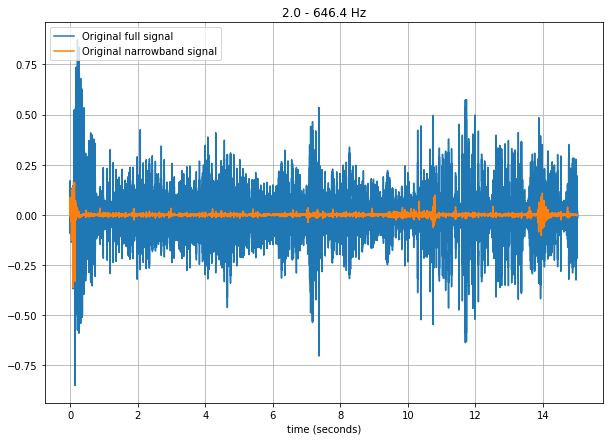

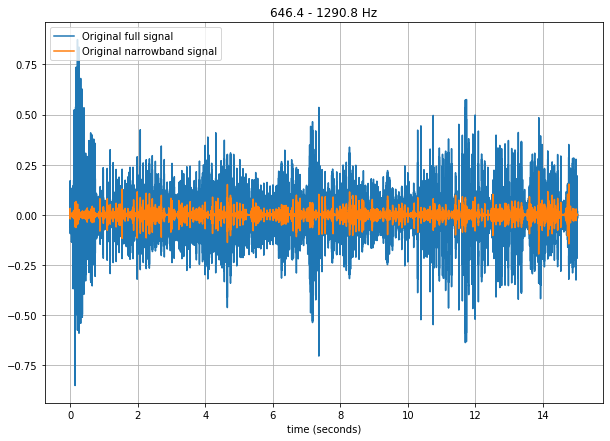

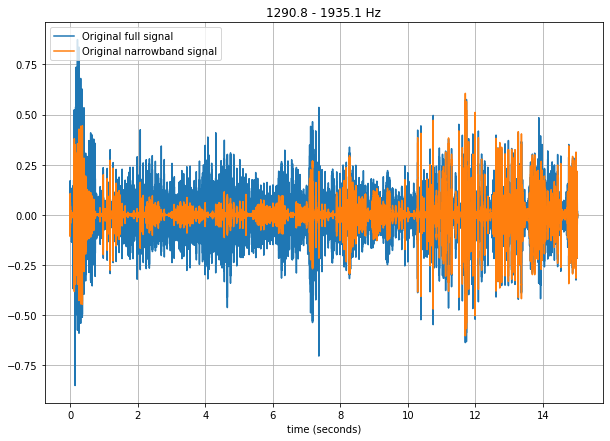

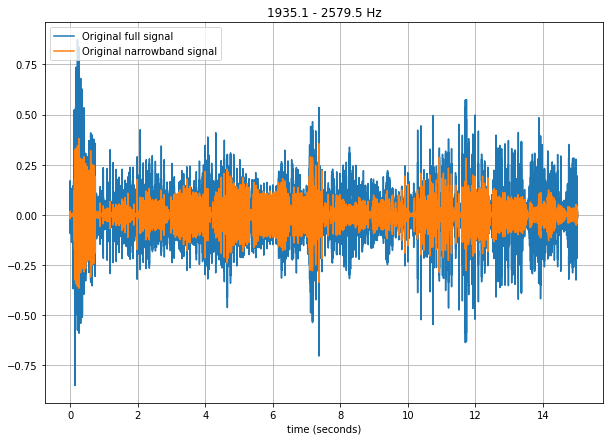

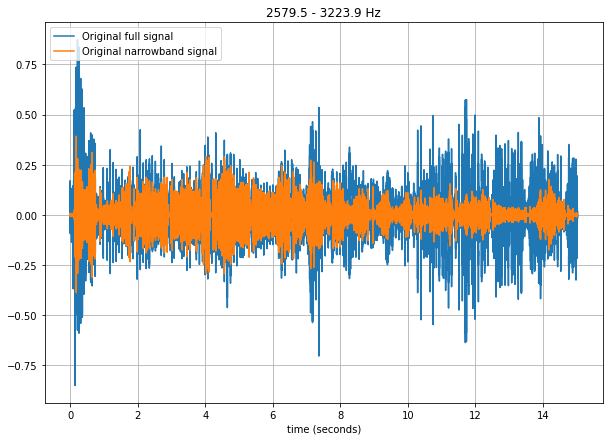

...

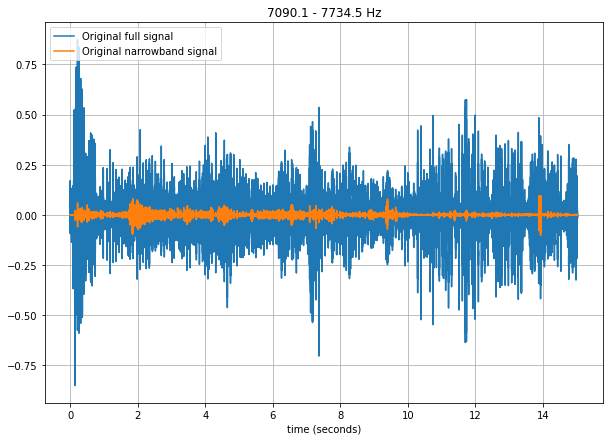

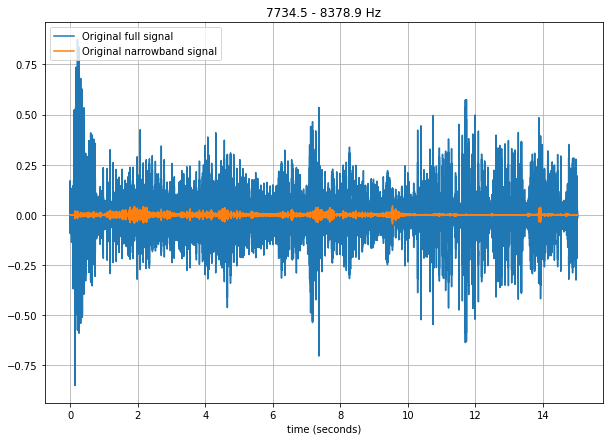

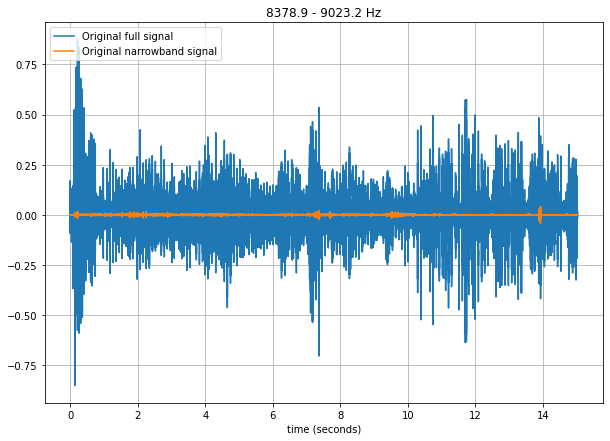

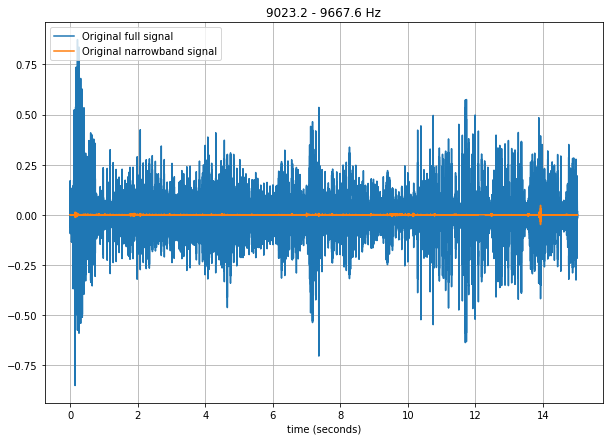

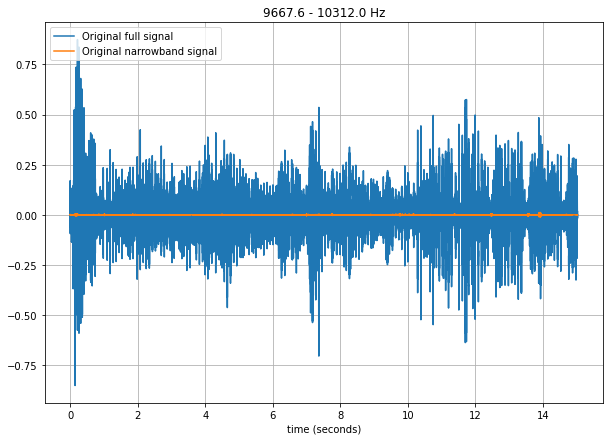

In [ ]:
bp_signalP1 = apply_bank_filters(signalP1, sr, freqs, plots=show_plots, bandwidth = 10, ripple_db = 50)

### Single Host

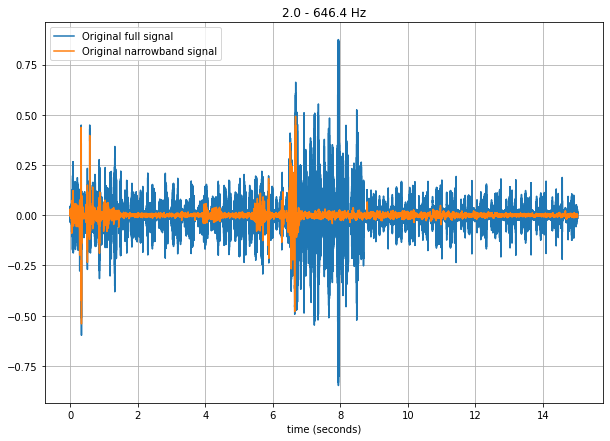

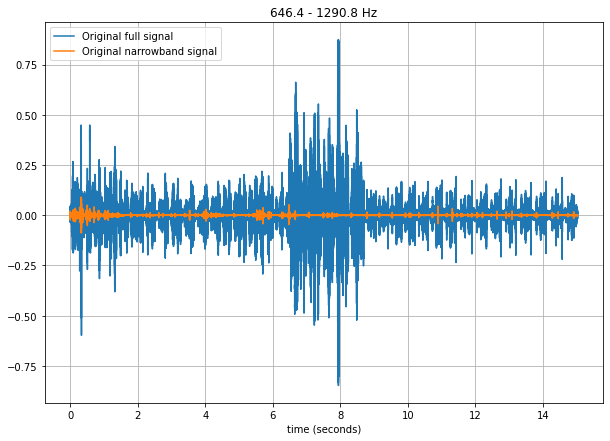

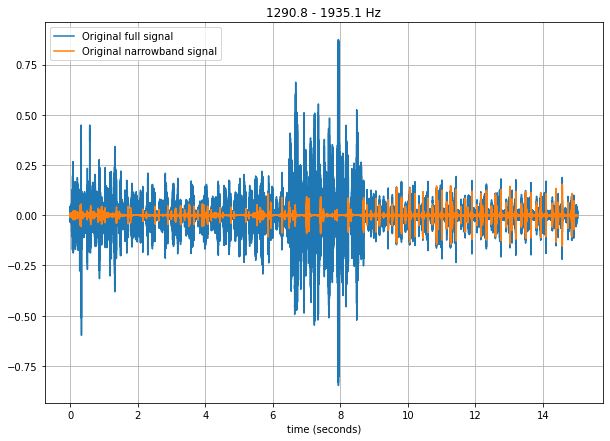

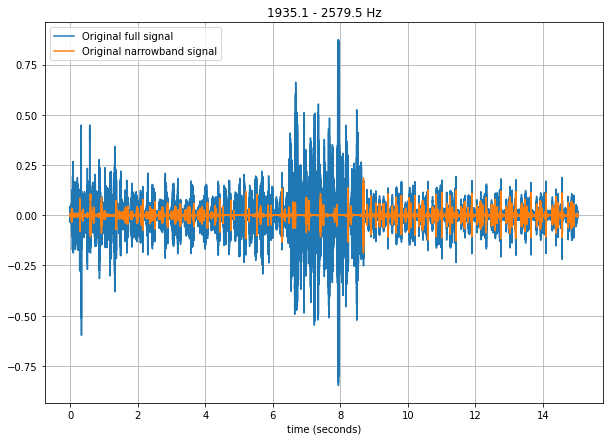

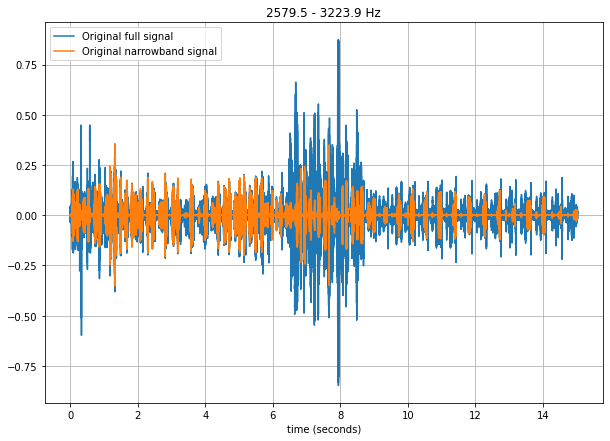

...

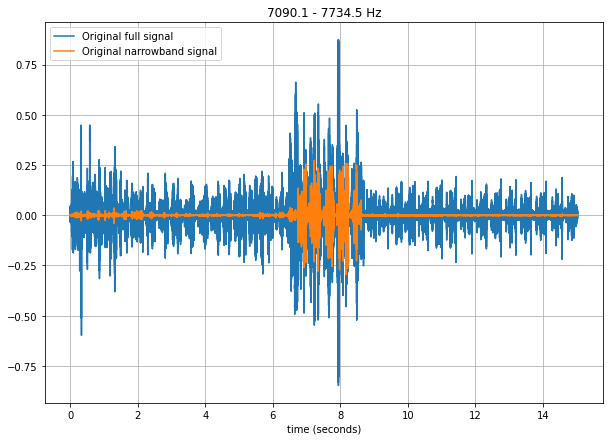

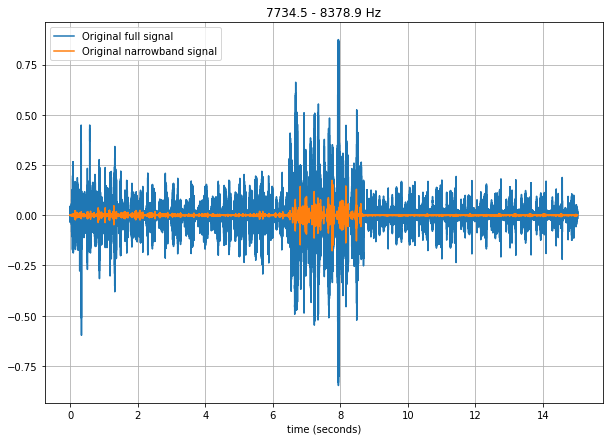

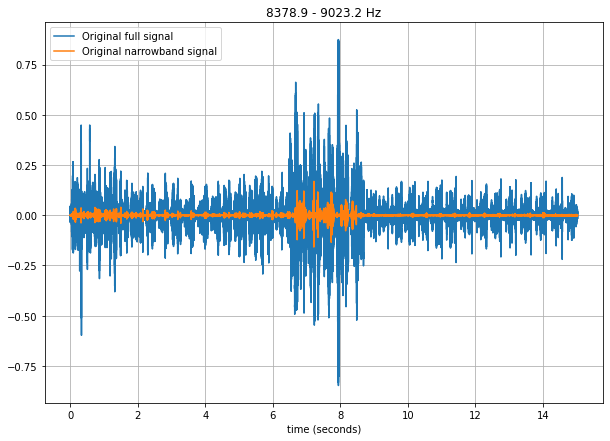

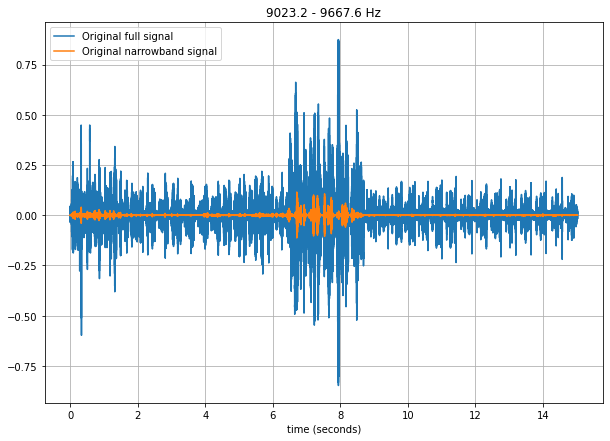

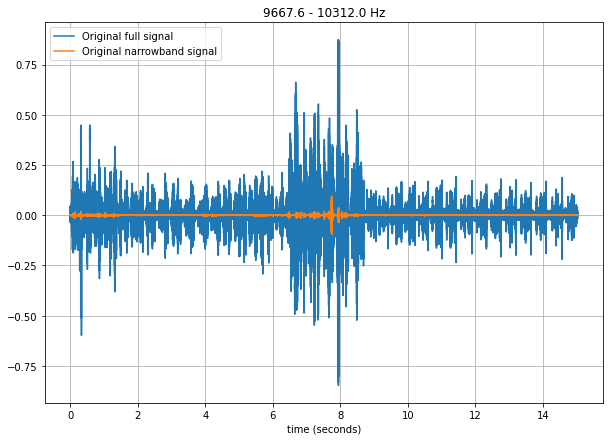

In [ ]:
bp_signalSH1 = apply_bank_filters(signalSH1, sr, freqs, plots=show_plots, bandwidth = 10, ripple_db = 50)

##  Get Amplitude Envelopes (AE)

###For Parasite

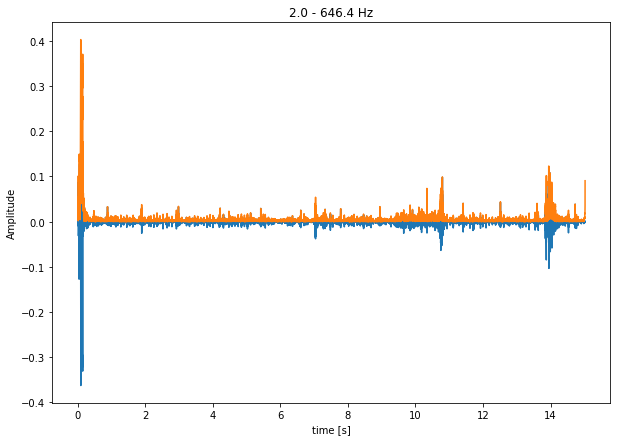

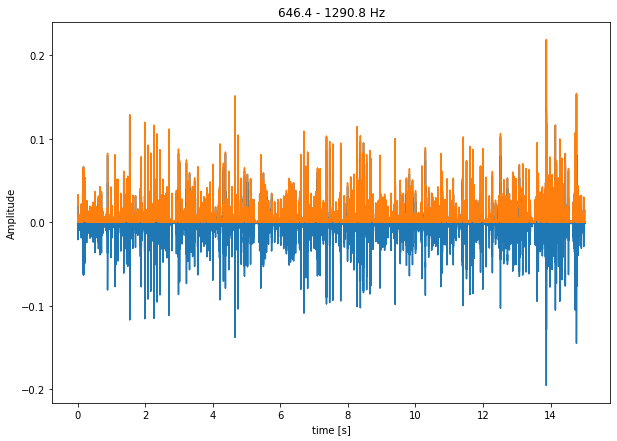

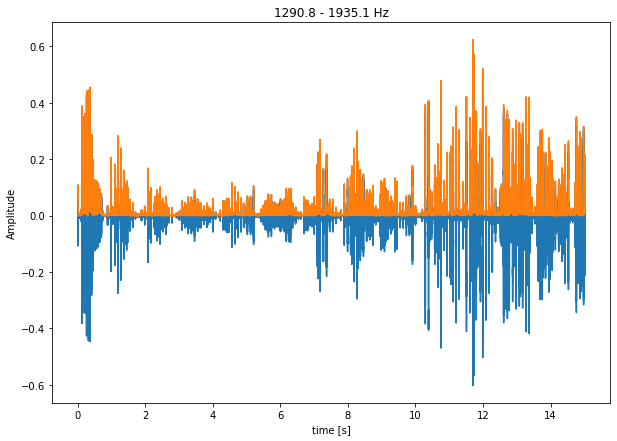

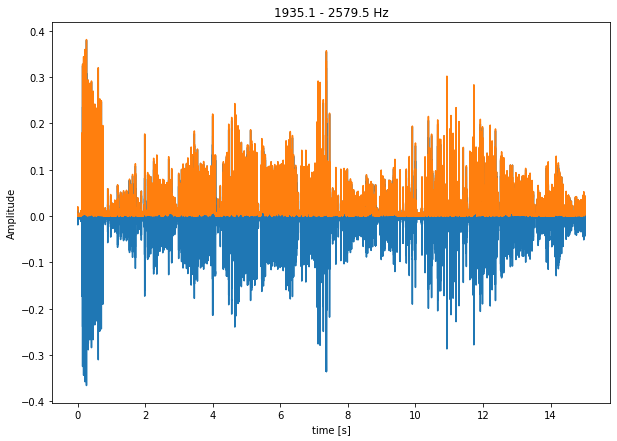

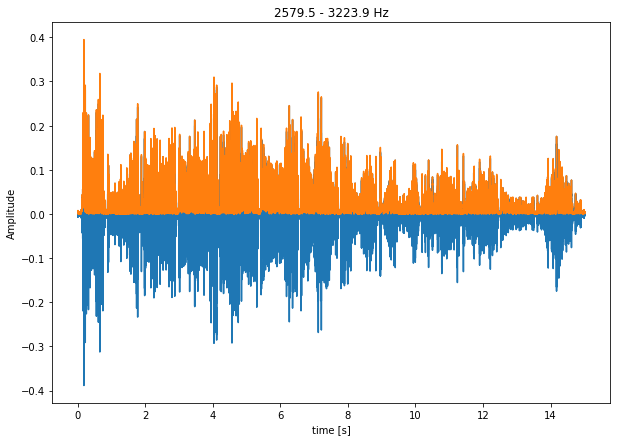

...

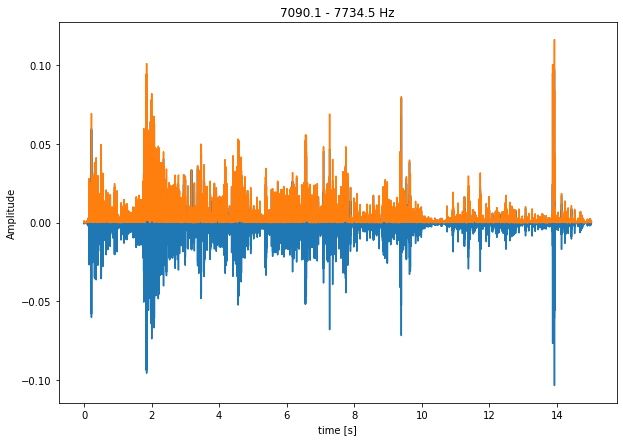

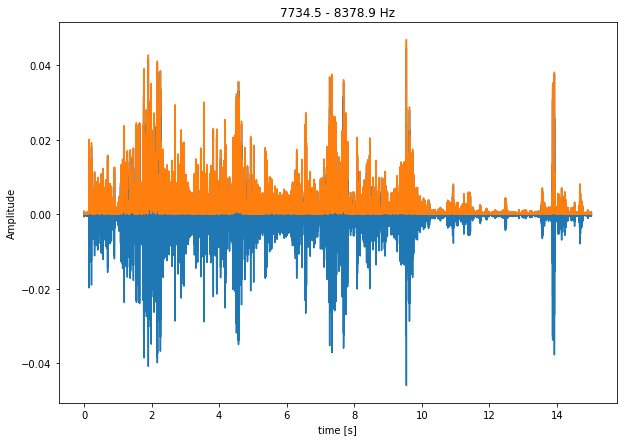

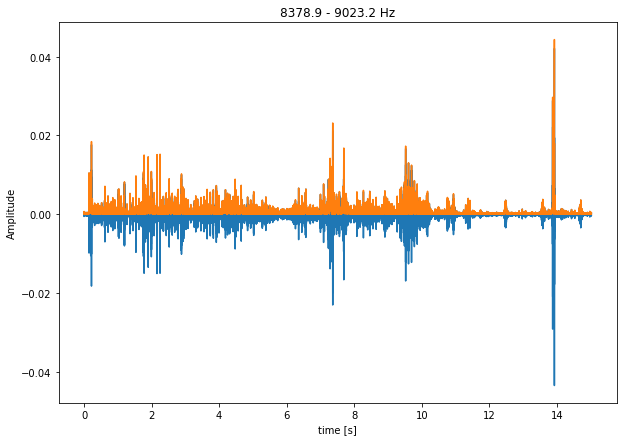

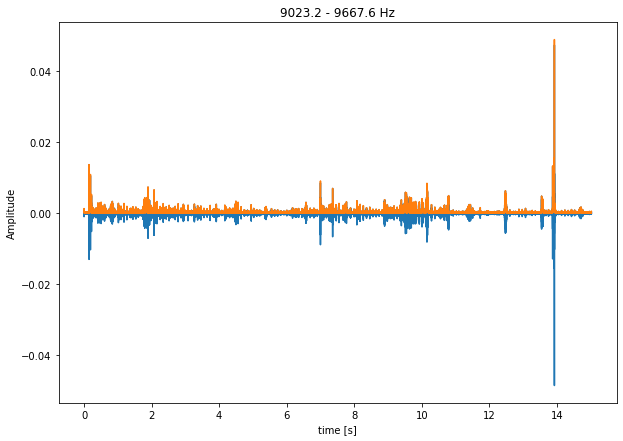

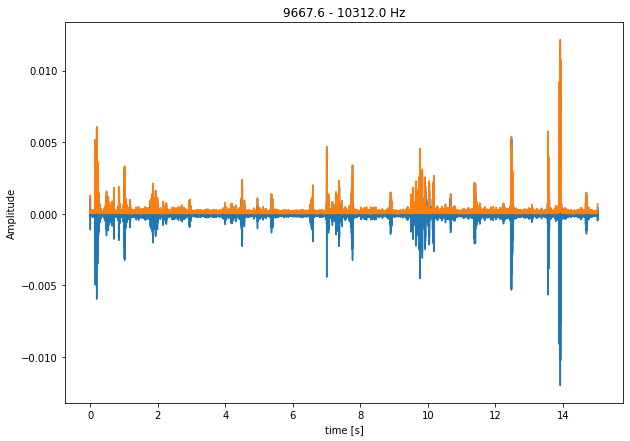

In [ ]:
amp_env_P1 = get_AE(bp_signalP1, sr, freqs, plots=show_plots)

###For Single Host

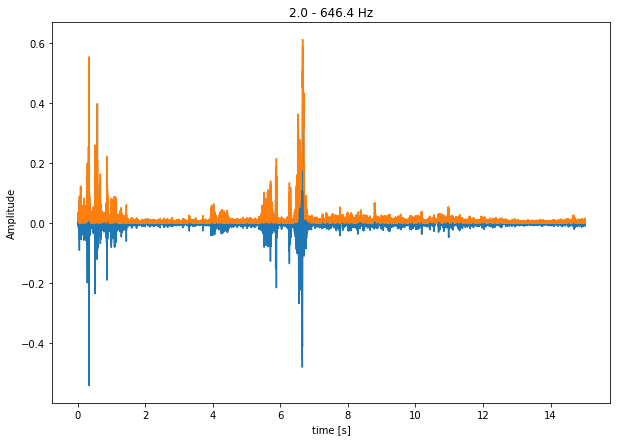

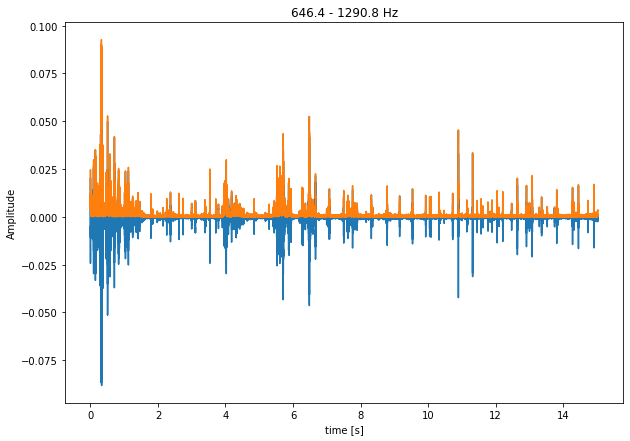

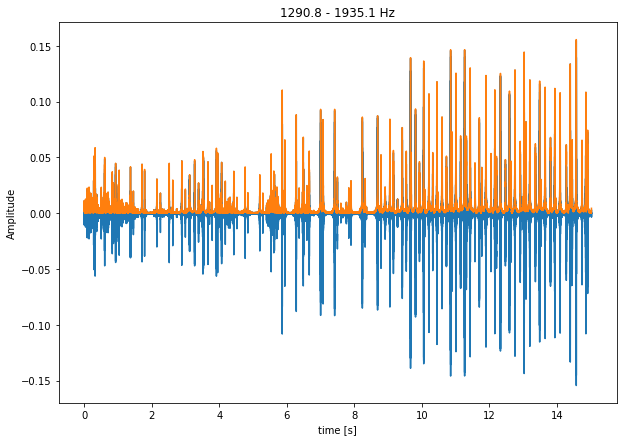

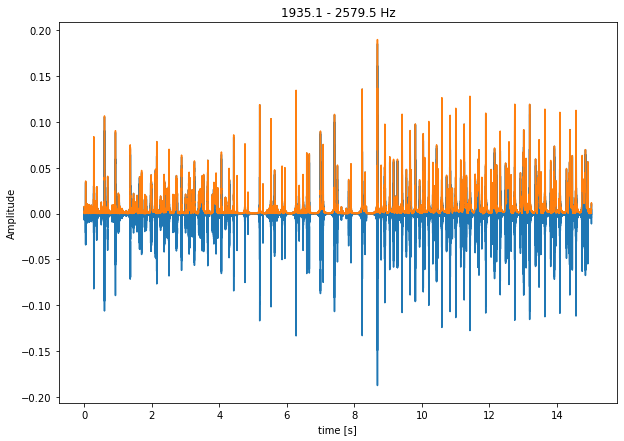

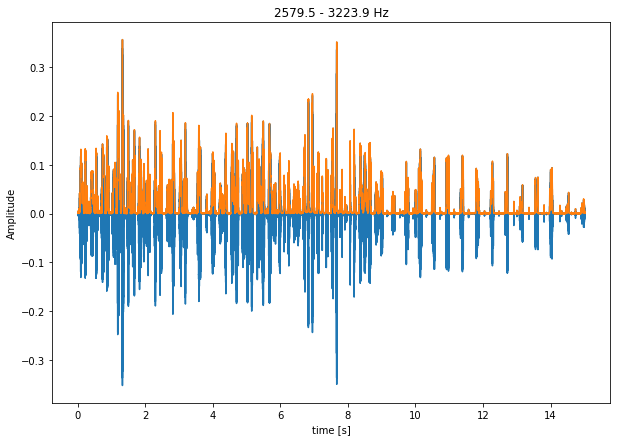

...

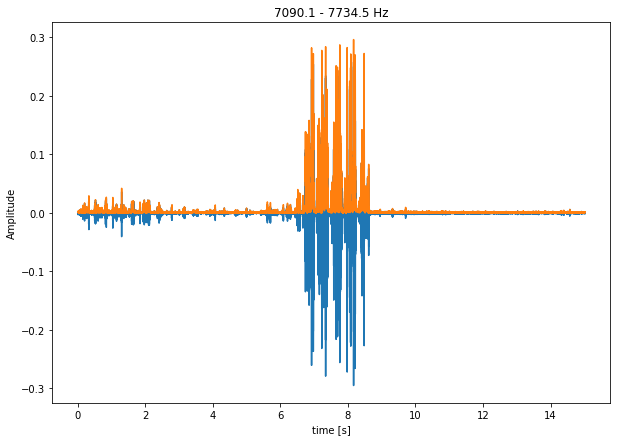

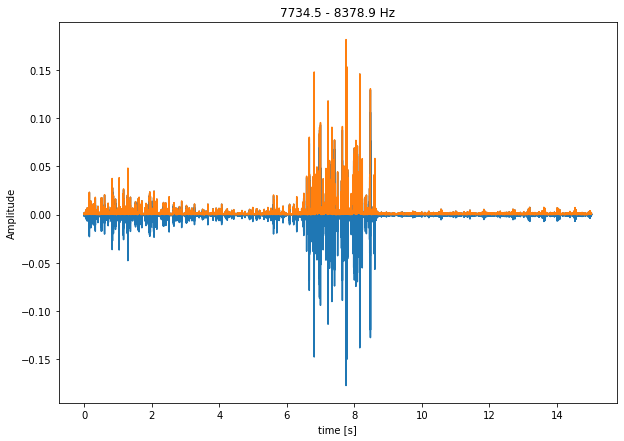

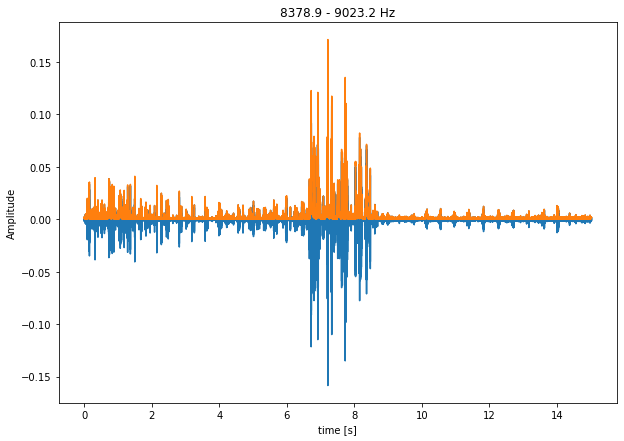

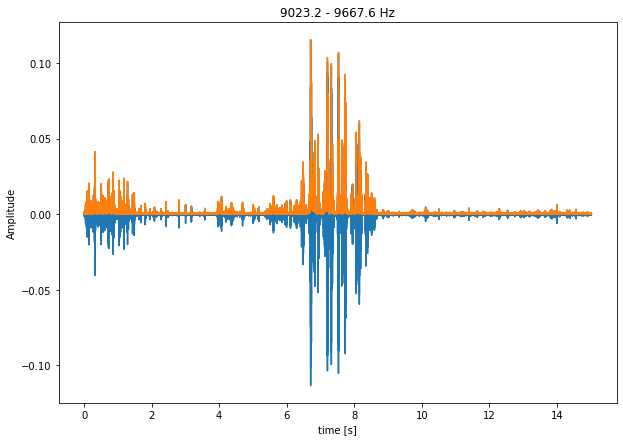

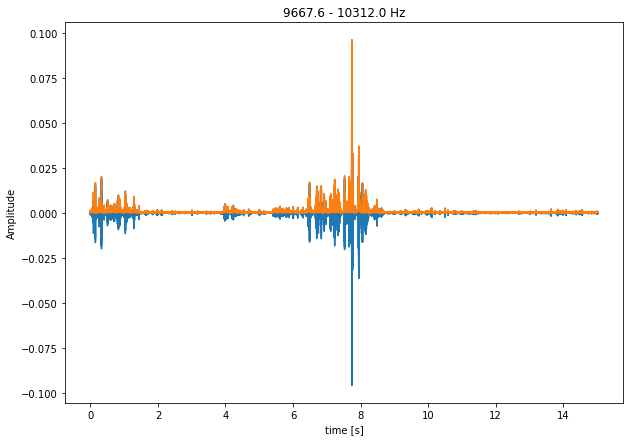

In [ ]:
amp_env_SH1 = get_AE(bp_signalSH1, sr, freqs, plots=show_plots)

##  Filter AEs using Butterworth bandstop filter

###For Parasite

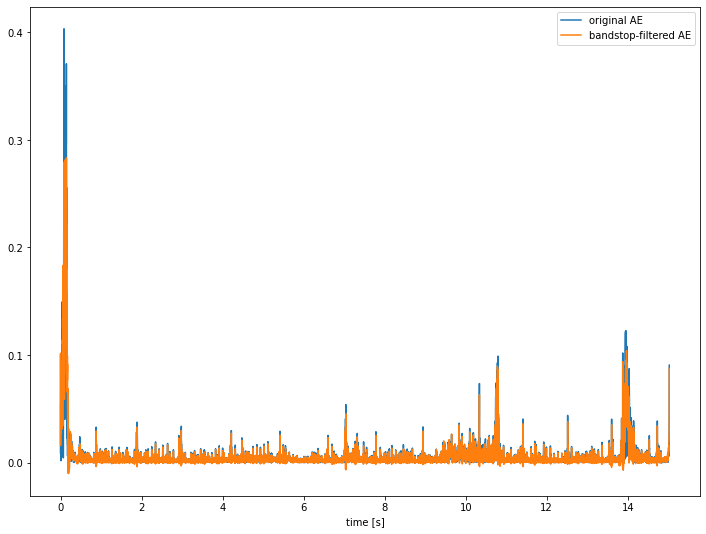

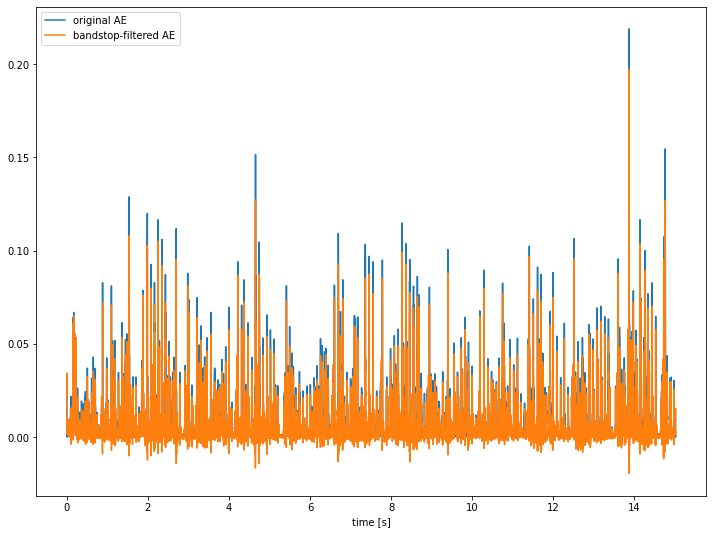

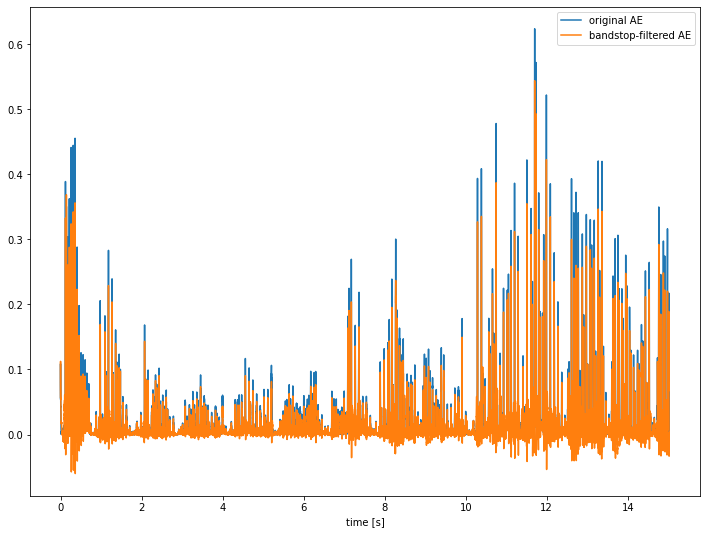

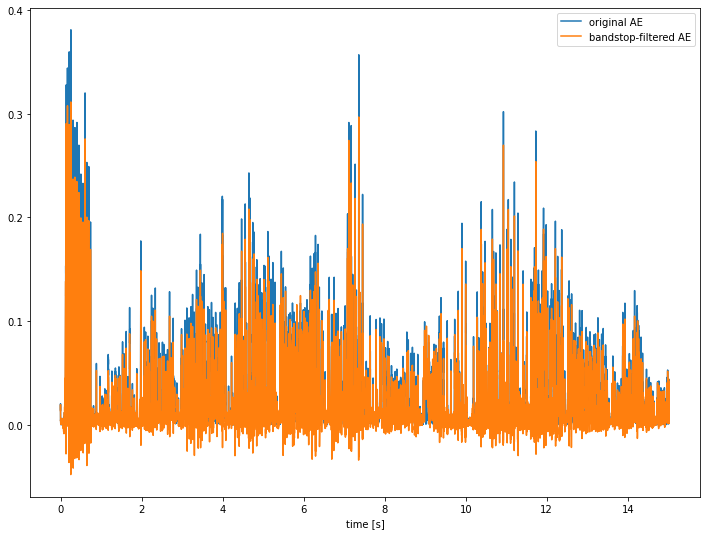

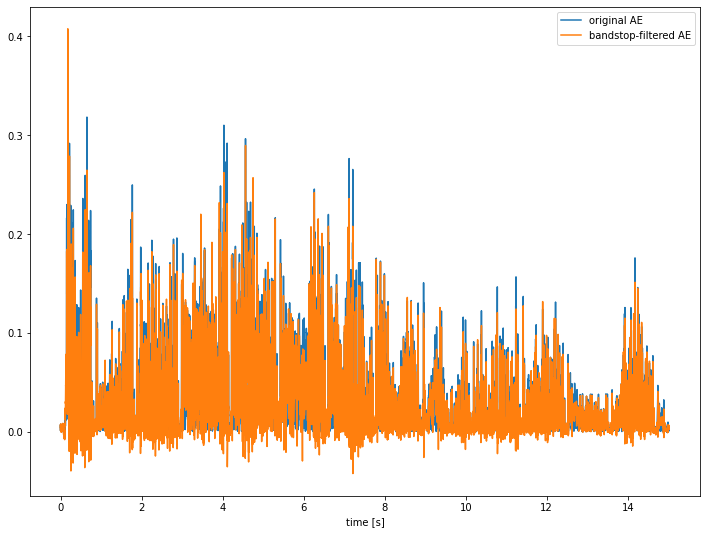

...

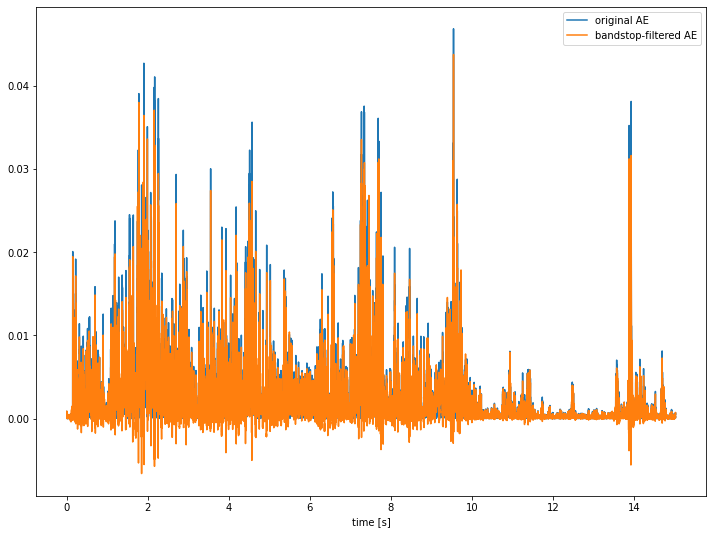

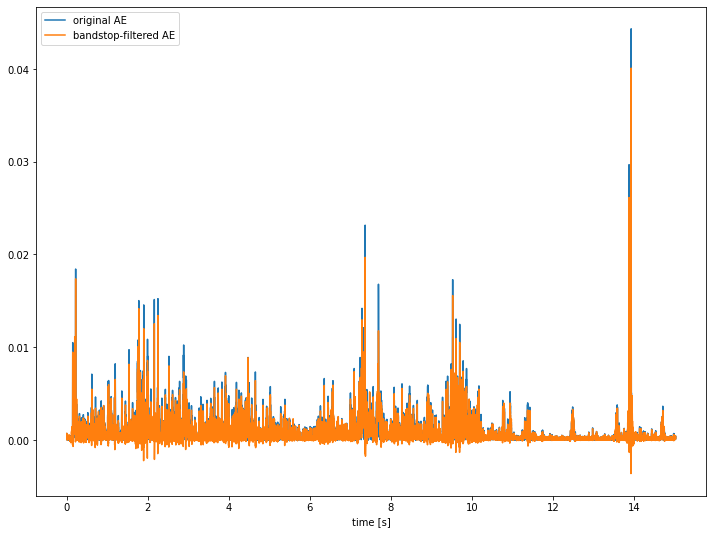

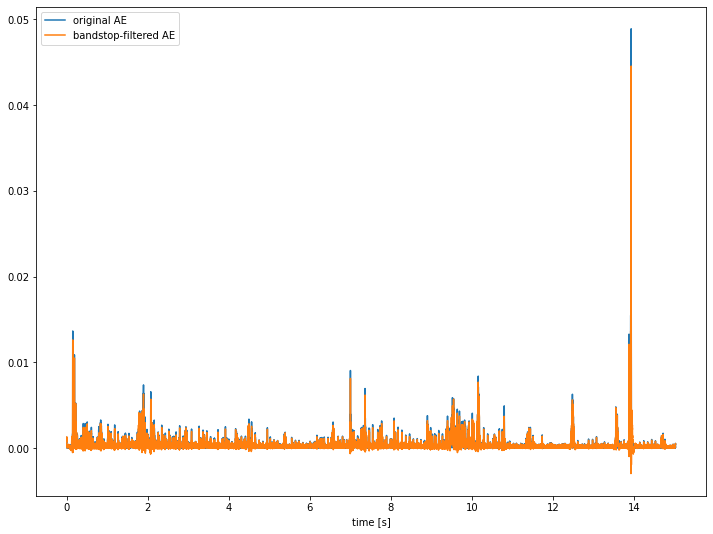

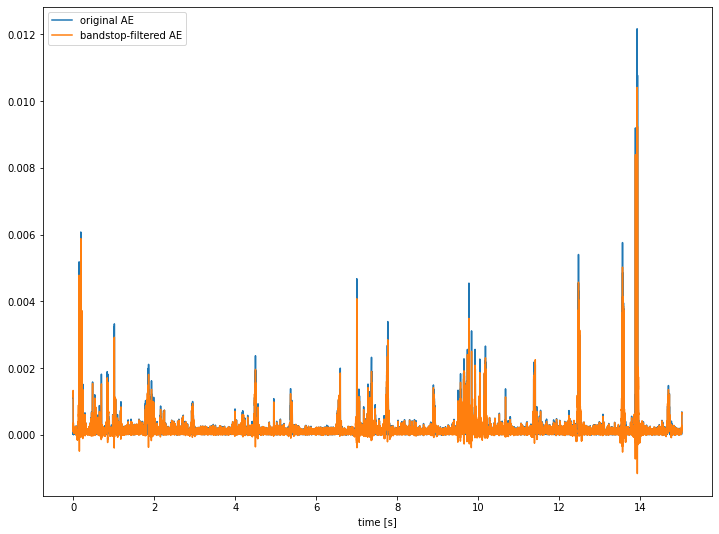

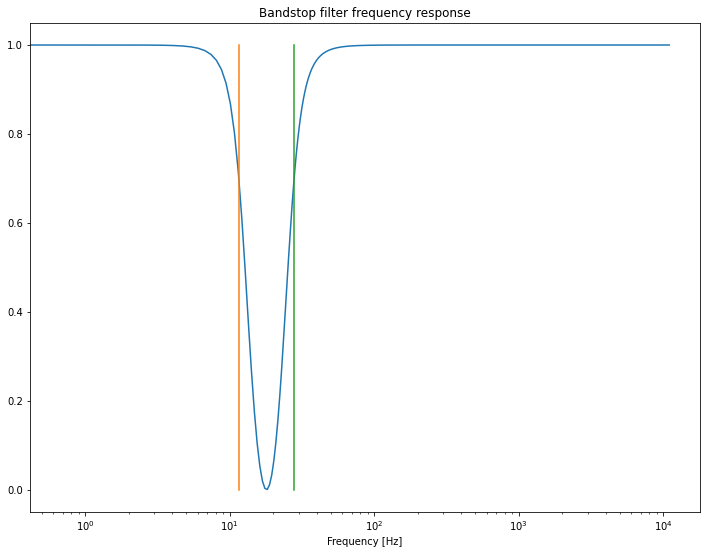

In [ ]:
amp_env_filtered_P1 = mod_amp_filter(amp_env_P1, sr, low_bs_f, high_bs_f, plots=show_plots, plot_response = 1)

###For Single Host

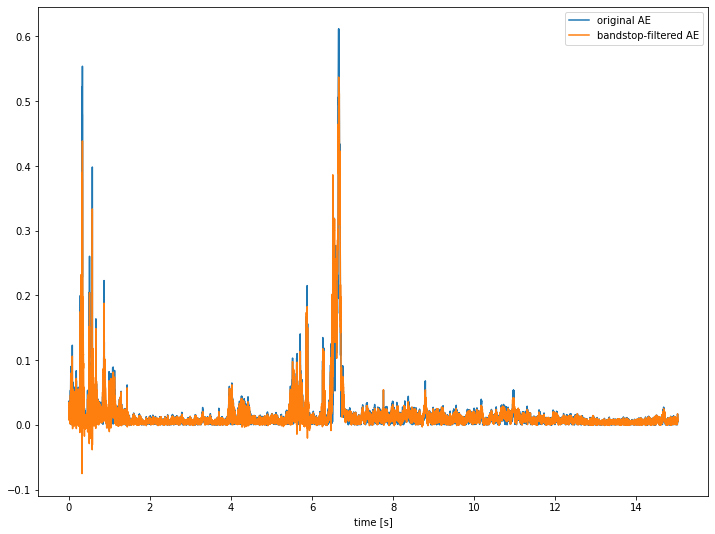

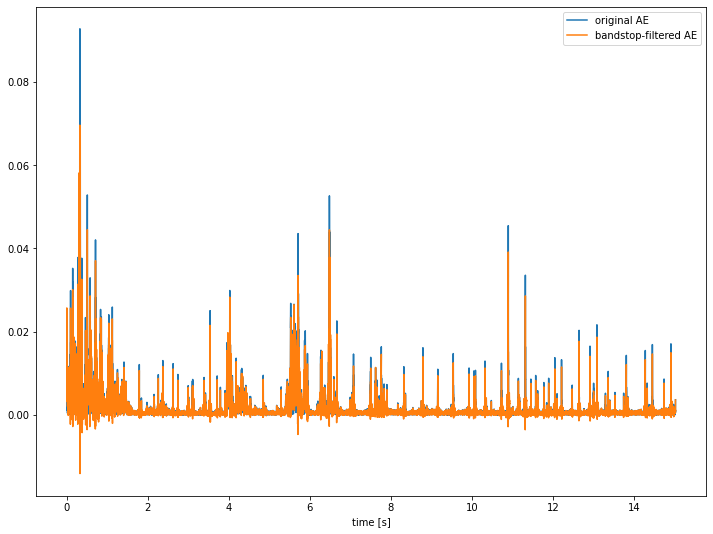

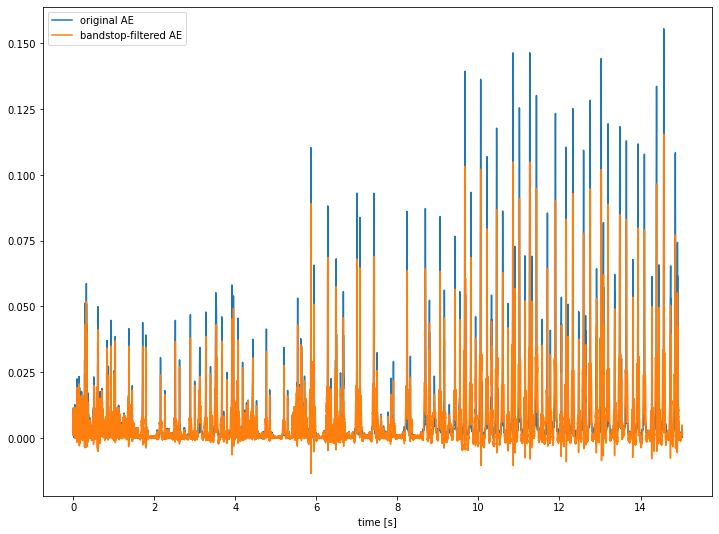

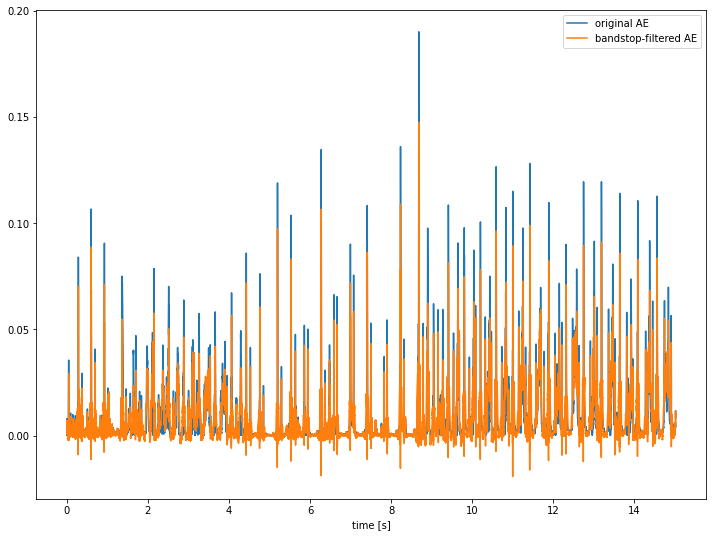

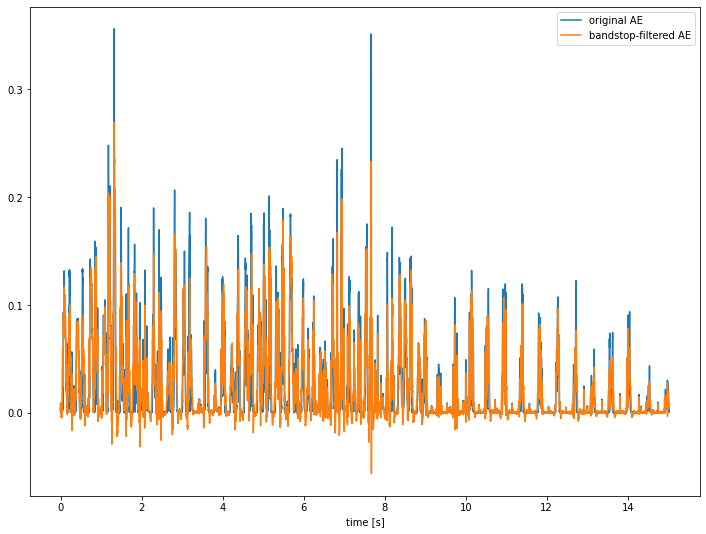

...

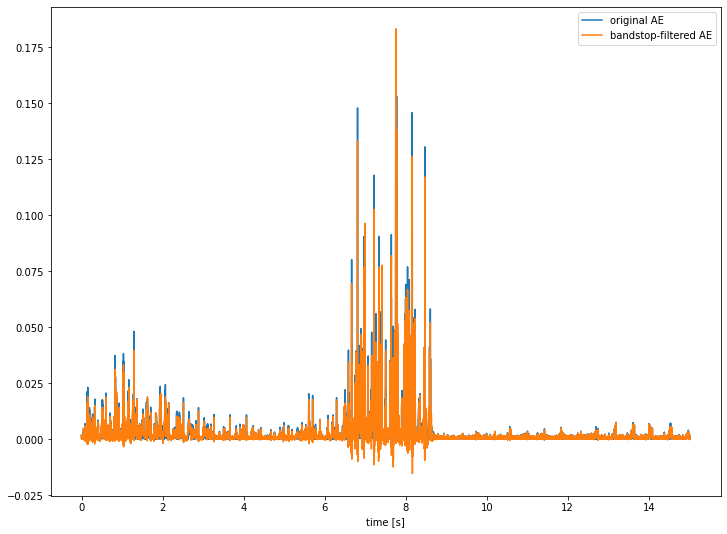

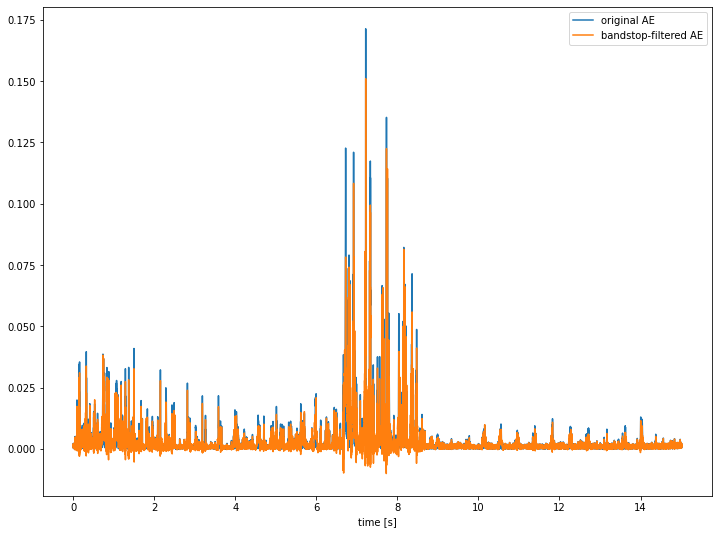

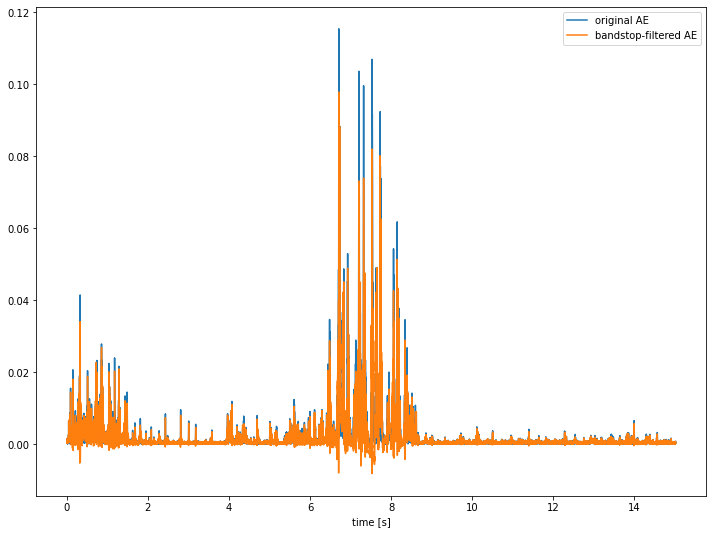

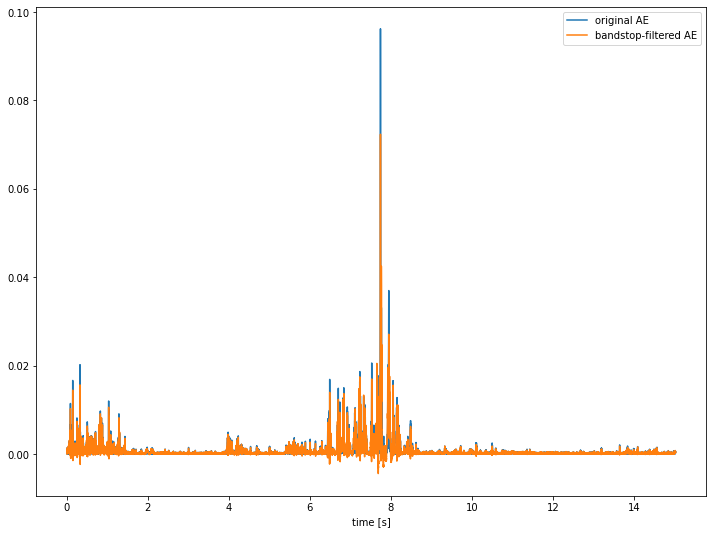

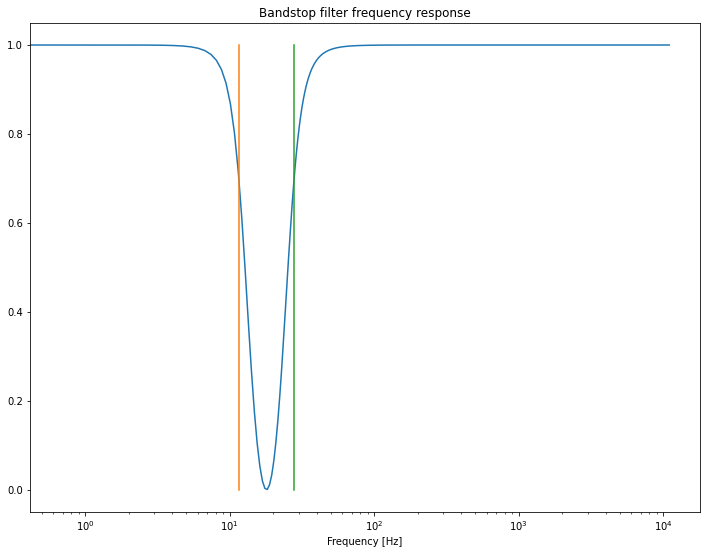

In [ ]:
amp_env_filtered_SH1 = mod_amp_filter(amp_env_SH1, sr, low_bs_f, high_bs_f, plots=show_plots, plot_response = 1)

## Power Spectral Density of filtered AE

###For Parasite 

Full filtered wideband signal AE

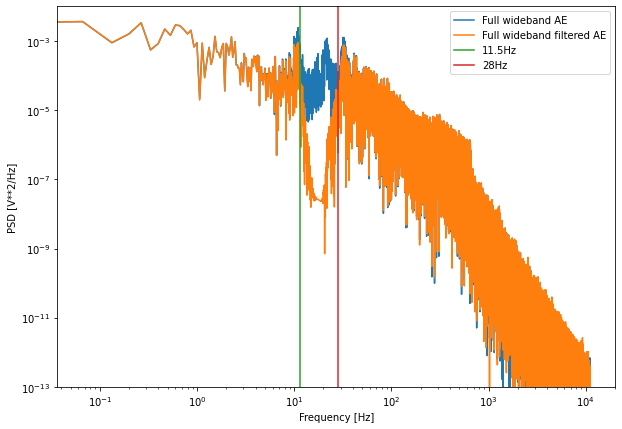

In [ ]:

full_amp_env_P1 = sum(amp_env_P1)
f_psd_o,psd_o = sig.periodogram(full_amp_env_P1,sr)

full_filt_amp_env_P1 = sum(amp_env_filtered_P1)
f_psd_f,psd_f = sig.periodogram(full_filt_amp_env_P1,sr)

plt.figure(figsize=(10,7))
plt.plot(f_psd_o,psd_o,label='Full wideband AE')
plt.plot(f_psd_f,psd_f,label='Full wideband filtered AE')
plt.xscale('log')
plt.yscale('log')
plt.xlabel('Frequency [Hz]')
plt.ylabel('PSD [V**2/Hz]')
#plt.xlim([1,500])
plt.plot([low_bs_f,low_bs_f],[1e-14,1e-2],label = str(low_bs_f)+'Hz')
plt.plot([high_bs_f,high_bs_f],[1e-14,1e-2],label = str(high_bs_f)+'Hz')
plt.ylim([1e-13,1e-2])
plt.legend()
plt.show()

For filtered narrowband signals AE

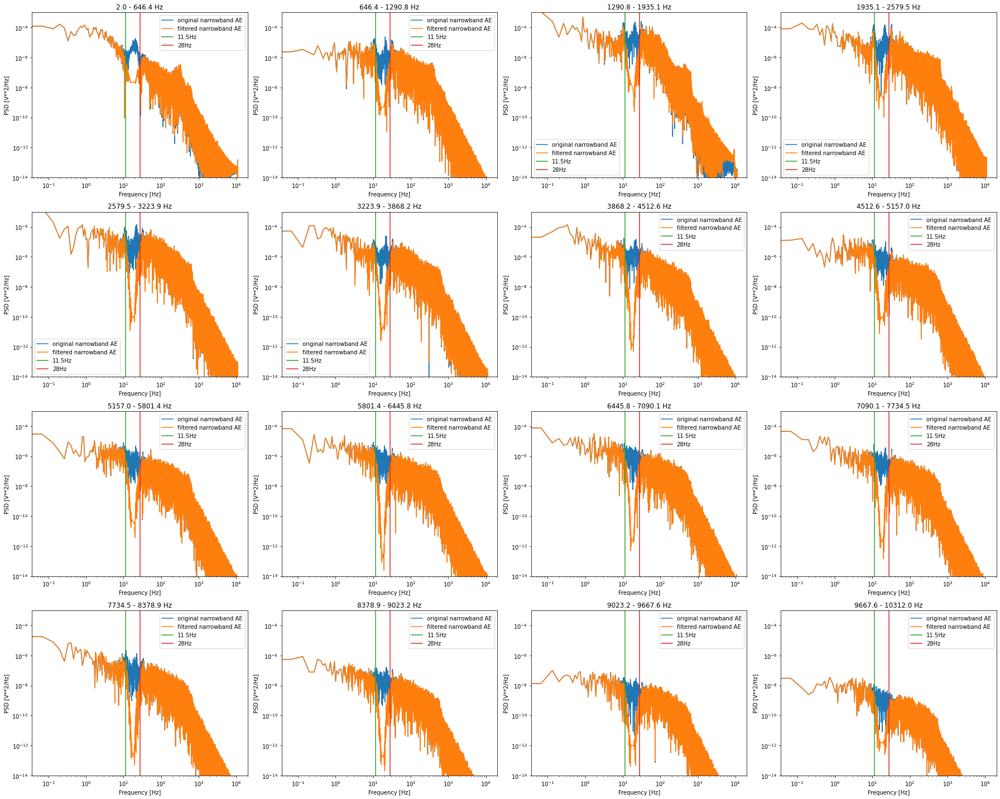

In [ ]:

rows = 4
cols = 4
n = rows*cols
fig, axes = plt.subplots(rows, cols, figsize=(25, 20))

f_i=0
for j in range(len(amp_env_filtered_P1)):

  r = j // cols
  c = j % cols
  ax = axes[r][c]
  lowcut = freqs[f_i]
  highcut = freqs[f_i+1]
  f_psd_o,psd_o = sig.periodogram(amp_env_P1[j],sr) # the original narrowband AE  
  f_psd_f,psd_f = sig.periodogram(amp_env_filtered_P1[j],sr)  # the filtered narrowband AE 

  ax.plot(f_psd_o,psd_o,label='original narrowband AE')
  ax.plot(f_psd_f,psd_f,label='filtered narrowband AE')
  ax.plot([low_bs_f,low_bs_f],[1e-14,1e-3],label = str(low_bs_f)+'Hz')
  ax.plot([high_bs_f,high_bs_f],[1e-14,1e-3],label = str(high_bs_f)+'Hz')
  ax.set_xscale('log')
  ax.set_yscale('log')
  ax.set_xlabel('Frequency [Hz]')
  ax.set_ylabel('PSD [V**2/Hz]')
  ##plt.xlim([1,500])
  ax.set_ylim([1e-14,1e-3])
  ax.legend()
  ax.set_title(str(round(lowcut,1))+' - '+str(round(highcut,1))+' Hz')
  f_i+=1
  
fig.tight_layout()  
plt.show()

### For Single Host

For the full filtered wideband signal AE

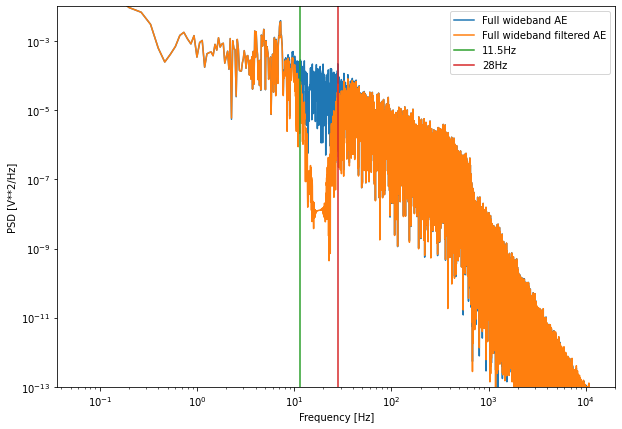

In [ ]:
full_amp_env_SH1 = sum(amp_env_SH1)
f_psd_o,psd_o = sig.periodogram(full_amp_env_SH1,sr)

full_filt_amp_env_SH1 = sum(amp_env_filtered_SH1)
f_psd_f,psd_f = sig.periodogram(full_filt_amp_env_SH1,sr)

plt.figure(figsize=(10,7))
plt.plot(f_psd_o,psd_o,label='Full wideband AE')
plt.plot(f_psd_f,psd_f,label='Full wideband filtered AE')
plt.xscale('log')
plt.yscale('log')
plt.xlabel('Frequency [Hz]')
plt.ylabel('PSD [V**2/Hz]')
#plt.xlim([1,500])
plt.plot([low_bs_f,low_bs_f],[1e-14,1e-2],label = str(low_bs_f)+'Hz')
plt.plot([high_bs_f,high_bs_f],[1e-14,1e-2],label = str(high_bs_f)+'Hz')
plt.ylim([1e-13,1e-2])
plt.legend()
plt.show()

For filtered narrowband signals AE

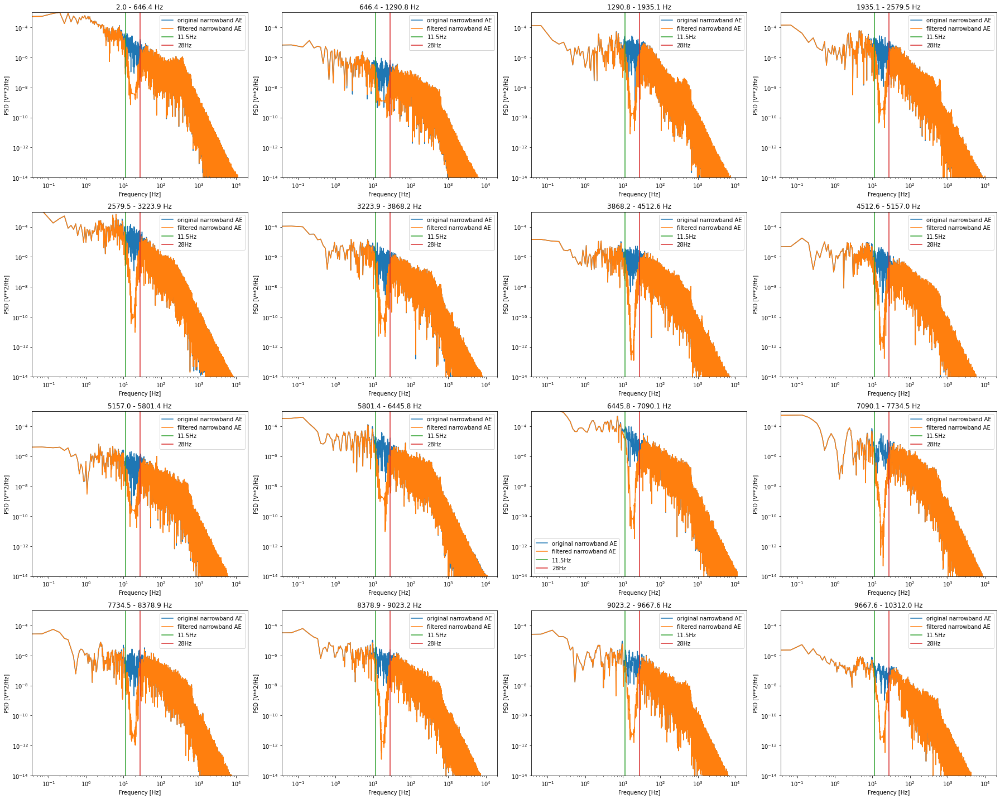

In [ ]:

rows = 4
cols = 4
n = rows*cols
fig, axes = plt.subplots(rows, cols, figsize=(25, 20))

f_i=0
for j in range(len(amp_env_filtered_SH1)):

  r = j // cols
  c = j % cols
  ax = axes[r][c]
  lowcut = freqs[f_i]
  highcut = freqs[f_i+1]
  f_psd_o,psd_o = sig.periodogram(amp_env_SH1[j],sr) # the original narrowband AE  
  f_psd_f,psd_f = sig.periodogram(amp_env_filtered_SH1[j],sr)  # the filtered narrowband AE 

  ax.plot(f_psd_o,psd_o,label='original narrowband AE')
  ax.plot(f_psd_f,psd_f,label='filtered narrowband AE')
  ax.plot([low_bs_f,low_bs_f],[1e-14,1e-3],label = str(low_bs_f)+'Hz')
  ax.plot([high_bs_f,high_bs_f],[1e-14,1e-3],label = str(high_bs_f)+'Hz')
  ax.set_xscale('log')
  ax.set_yscale('log')
  ax.set_xlabel('Frequency [Hz]')
  ax.set_ylabel('PSD [V**2/Hz]')
  ##plt.xlim([1,500])
  ax.set_ylim([1e-14,1e-3])
  ax.legend()
  ax.set_title(str(round(lowcut,1))+' - '+str(round(highcut,1))+' Hz')
  f_i+=1
  
fig.tight_layout()  
plt.show()

## Find diff between original AEs and filtered AEs

###For Parasite

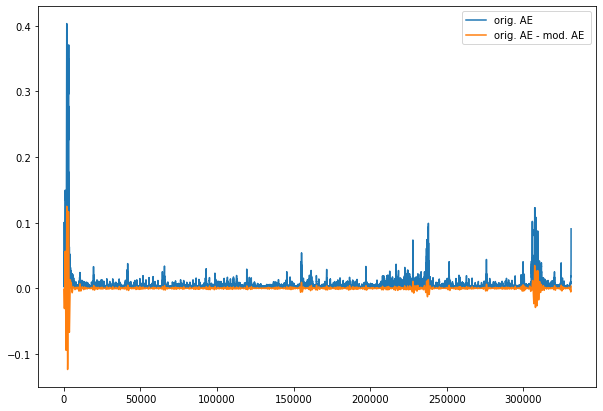

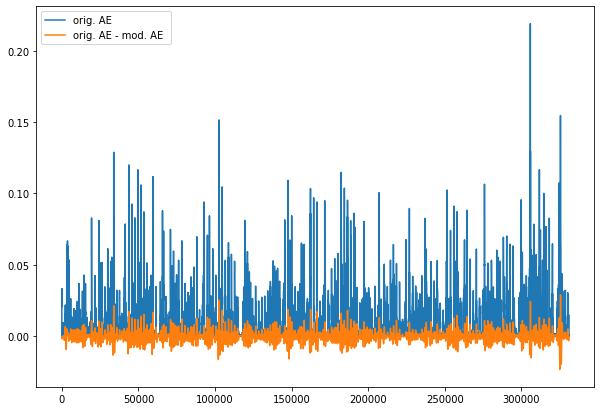

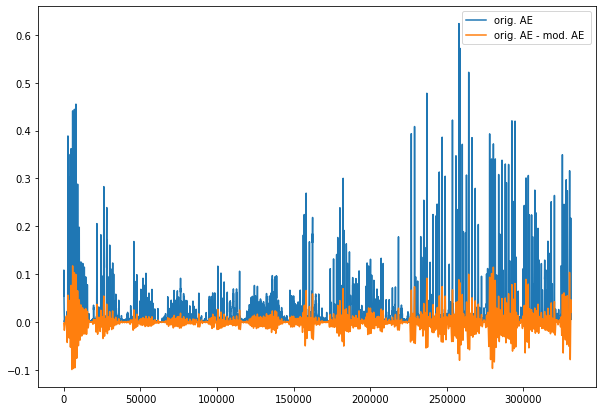

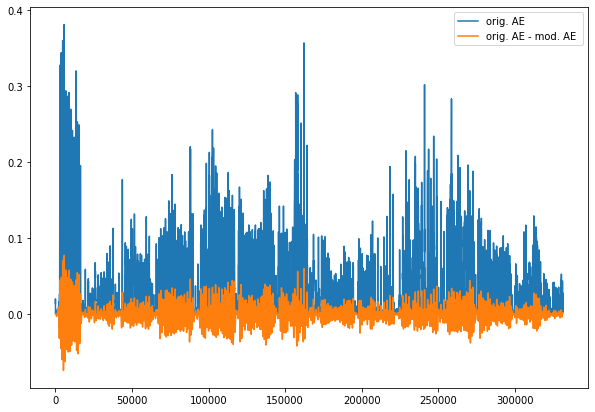

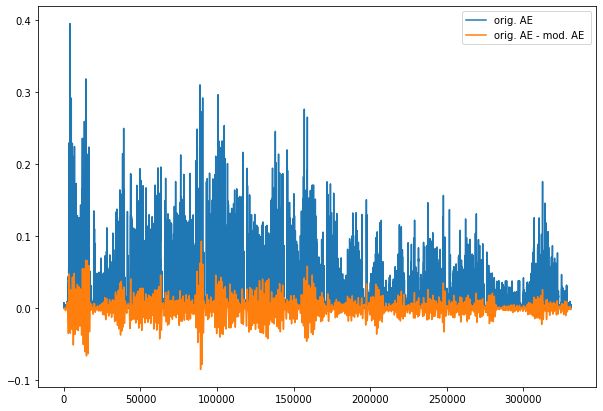

...

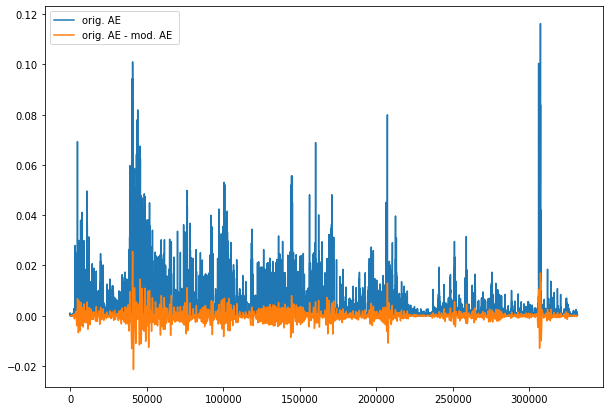

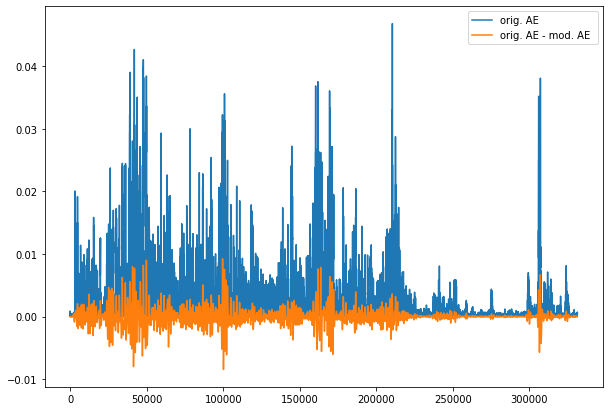

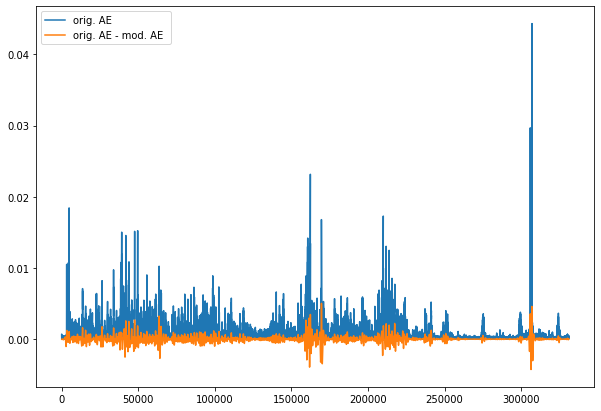

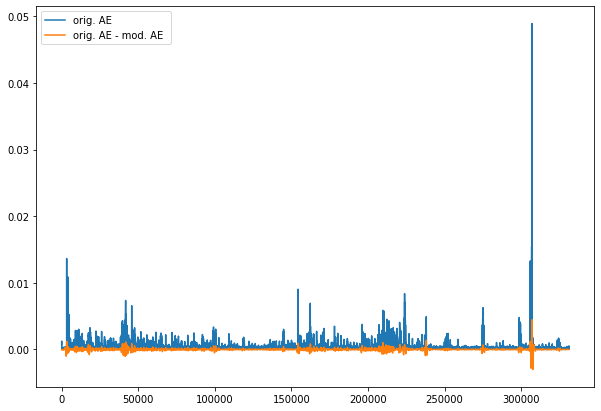

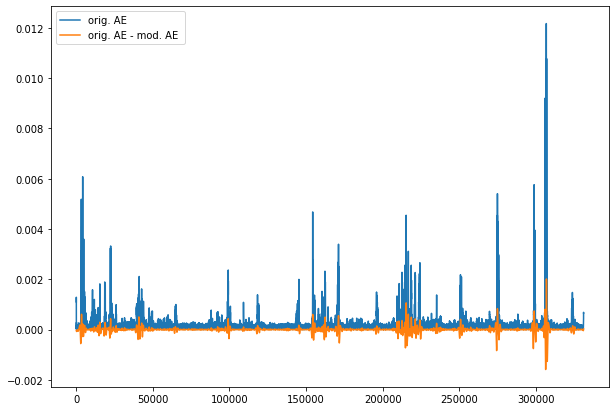

In [ ]:
sig_removed_P1 = sig_removed(amp_env_P1, amp_env_filtered_P1, plots = show_plots)

###For Single Host

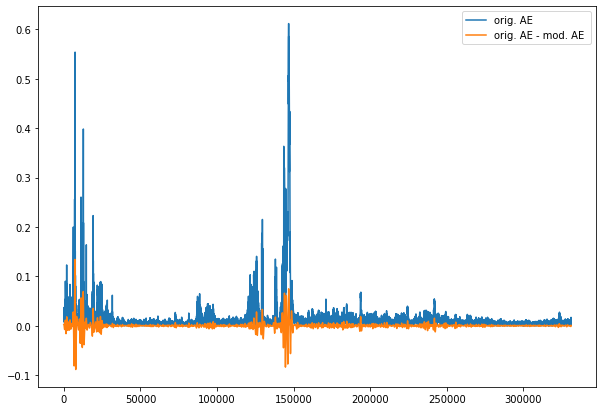

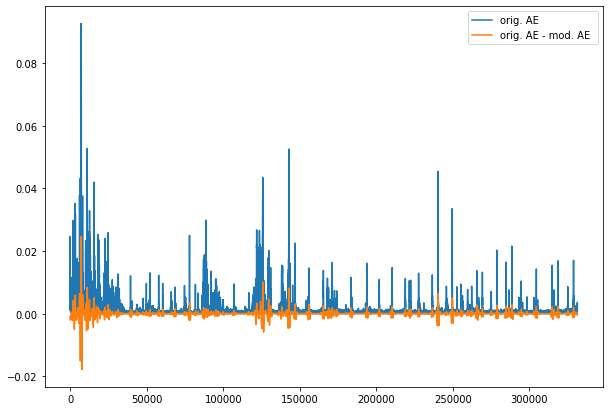

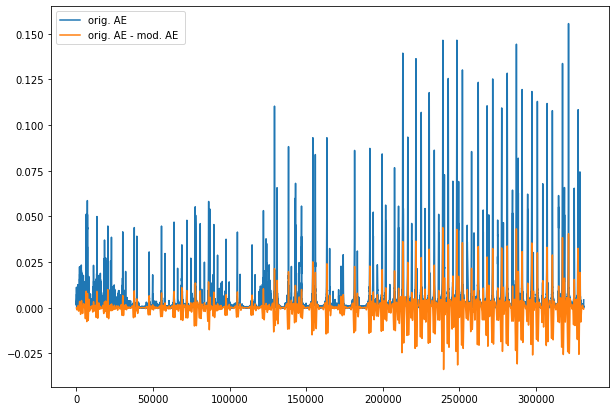

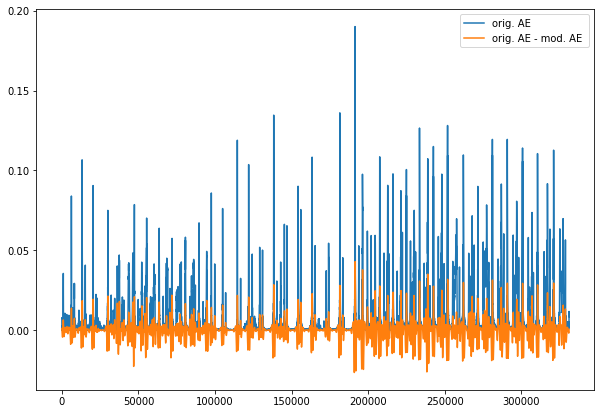

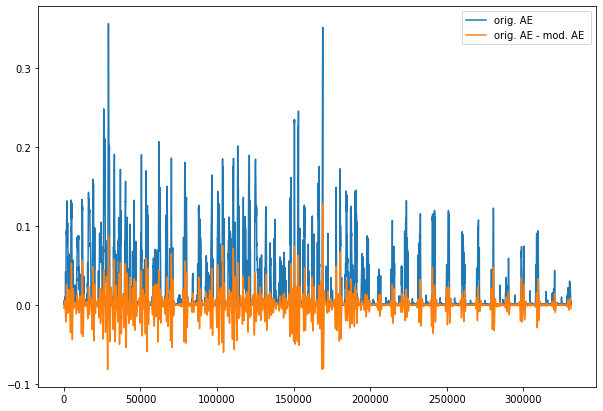

...

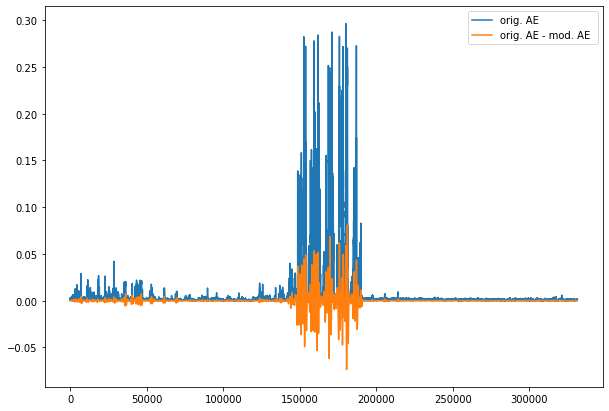

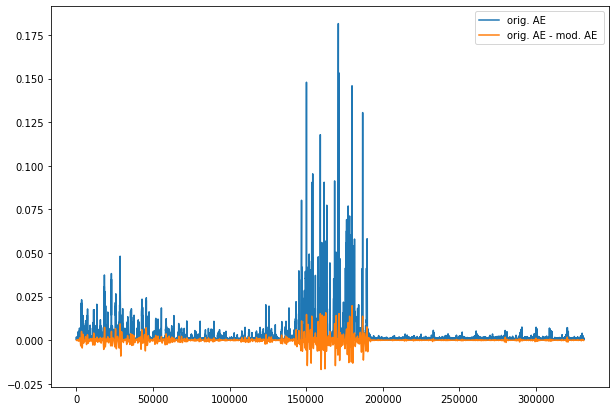

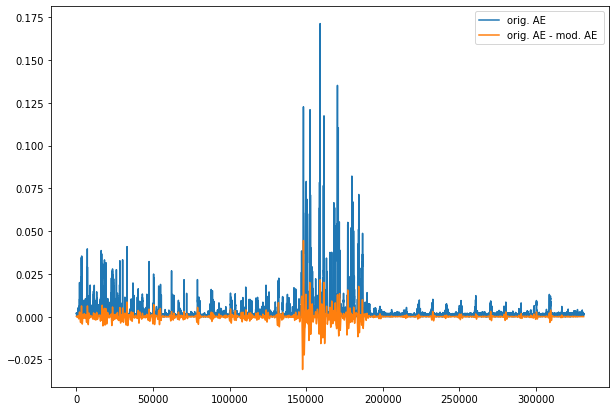

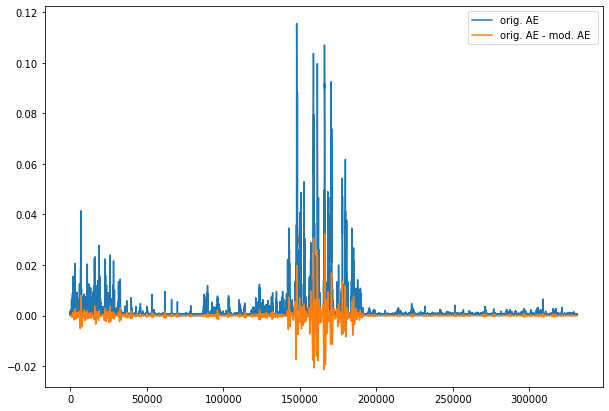

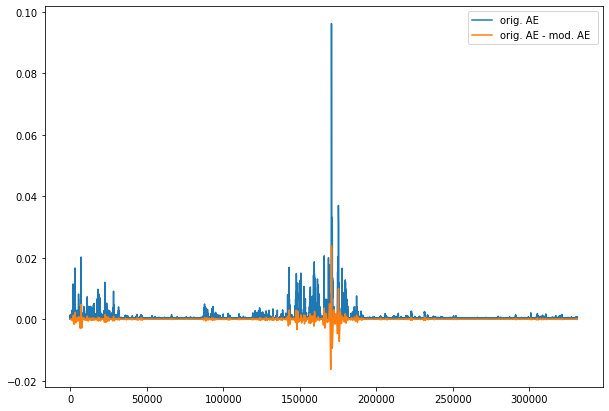

In [ ]:
sig_removed_SH1 = sig_removed(amp_env_SH1, amp_env_filtered_SH1, plots = show_plots)

# Implant with replacement (IR)

### For Parasite

#### with Single Host as the donor

In [ ]:
ir_amp_env_P1 = implant(amp_env_filtered_P1, sig_removed_SH1)

#### with Parasite as the donor (i.e. retrieve original Parasite signal)

In [ ]:
retrieve_amp_env_P1 = implant(amp_env_filtered_P1, sig_removed_P1)

###For Single Host

#### with Parasite as the donor

In [ ]:
ir_amp_env_SH1 = implant(amp_env_filtered_SH1, sig_removed_P1)

#### with Single Host as the donor (i.e. retrieve original Single Host signal)

In [ ]:
retrieve_amp_env_SH1 = implant(amp_env_filtered_SH1, sig_removed_SH1)

# Implant with addition (IA)

### For Parasite

In [ ]:
ia_amp_env_P1 = implant(amp_env_P1, sig_removed_SH1)

###For Single Host

In [ ]:
ia_amp_env_SH1 = implant(amp_env_SH1, sig_removed_P1)

# Half wave rectification


###For Parasite

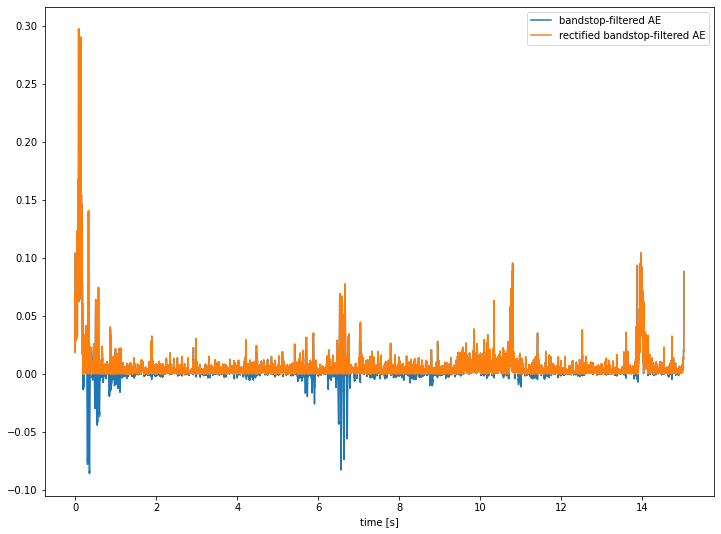

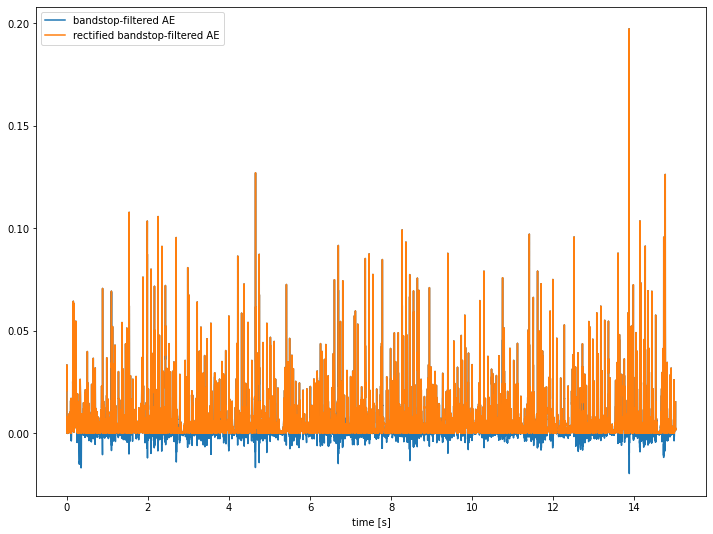

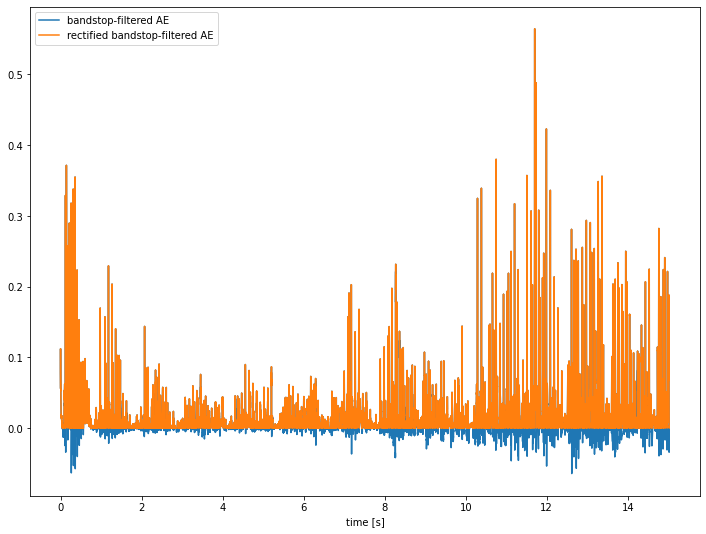

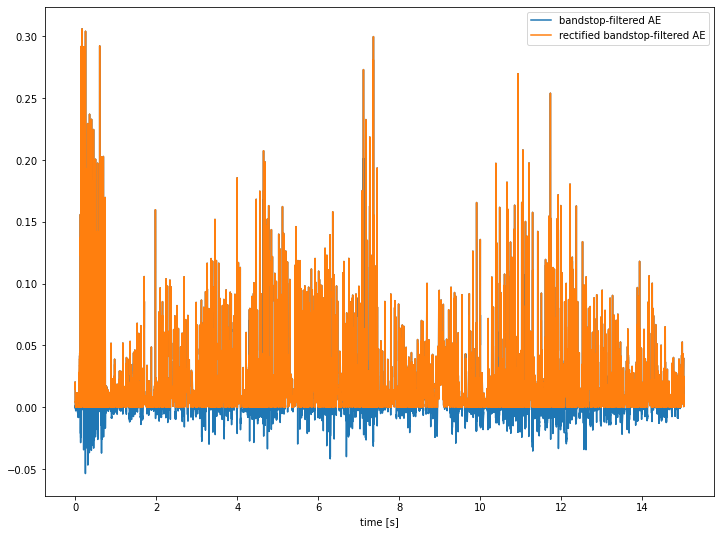

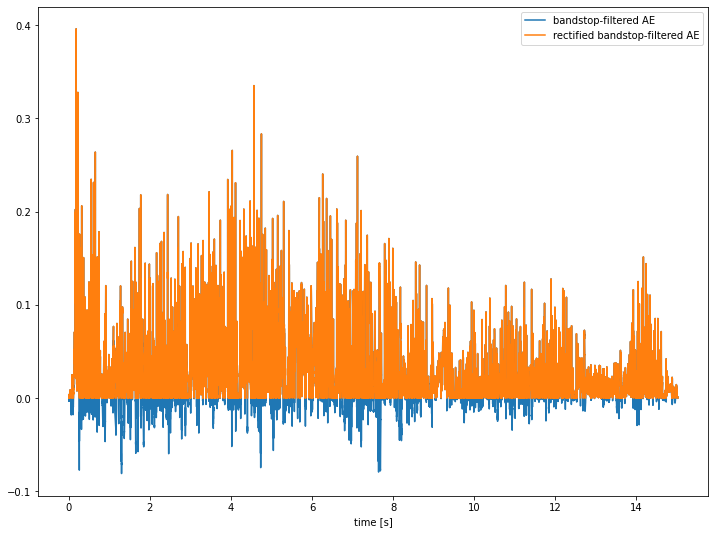

...

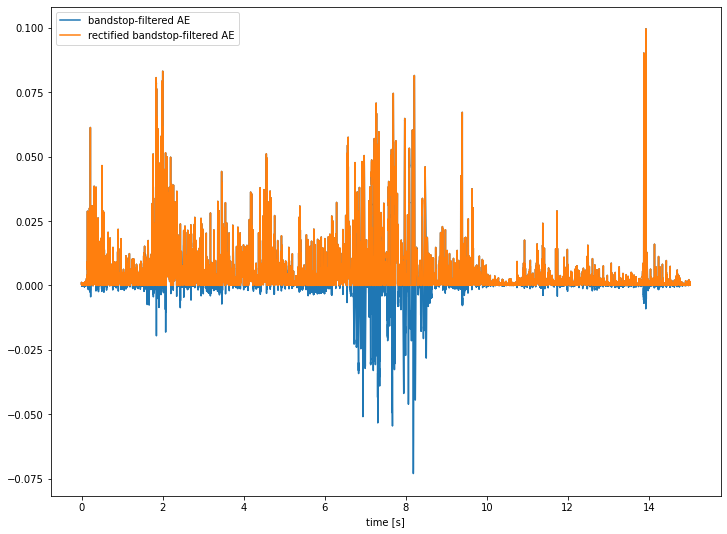

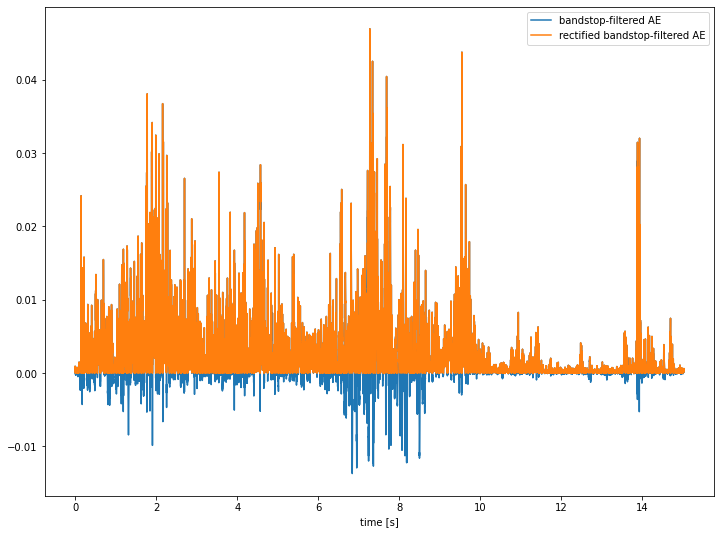

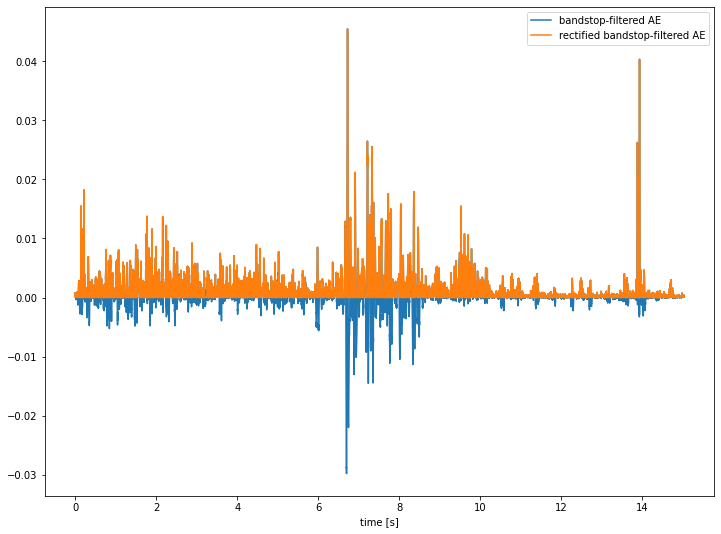

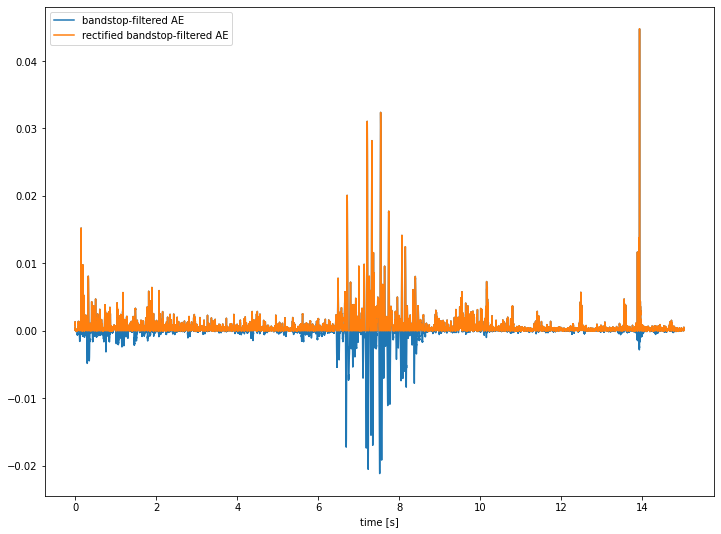

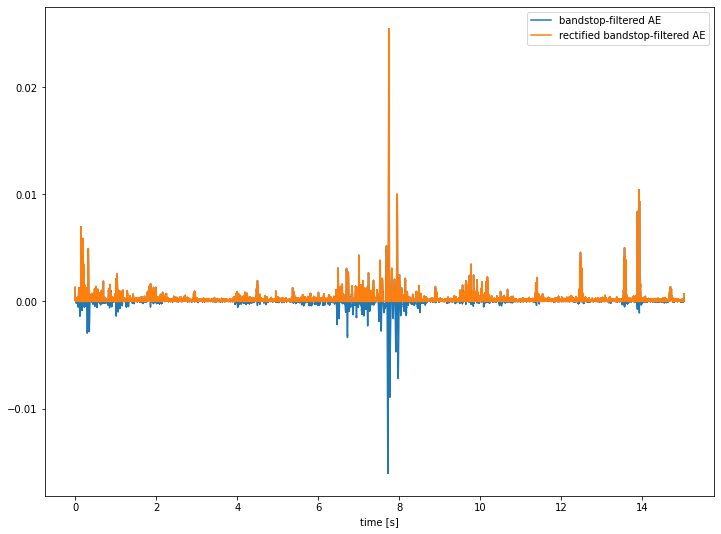

In [ ]:
ir_amp_env_rect_P1 = half_rectify(ir_amp_env_P1, sr, plots=show_plots)

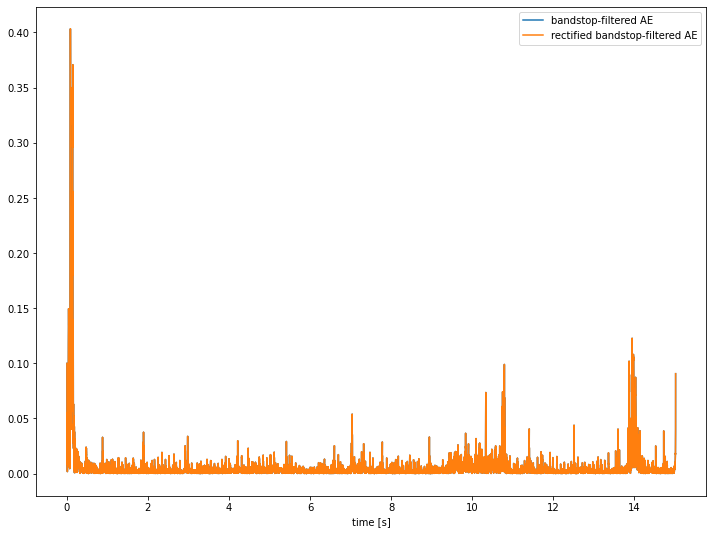

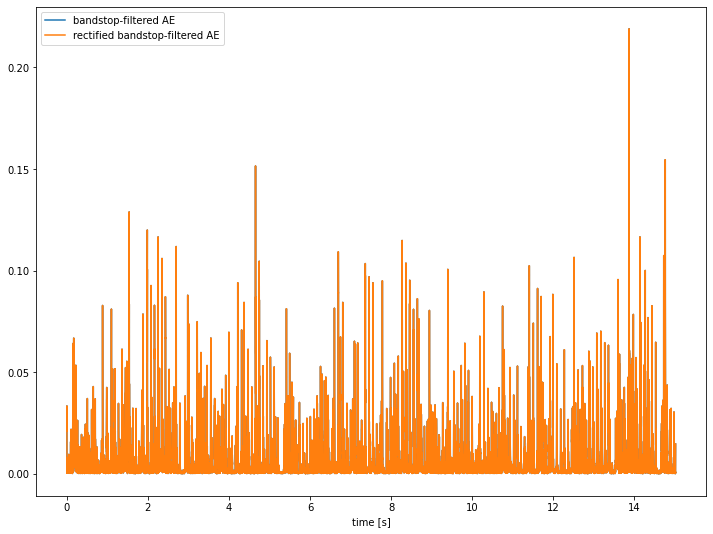

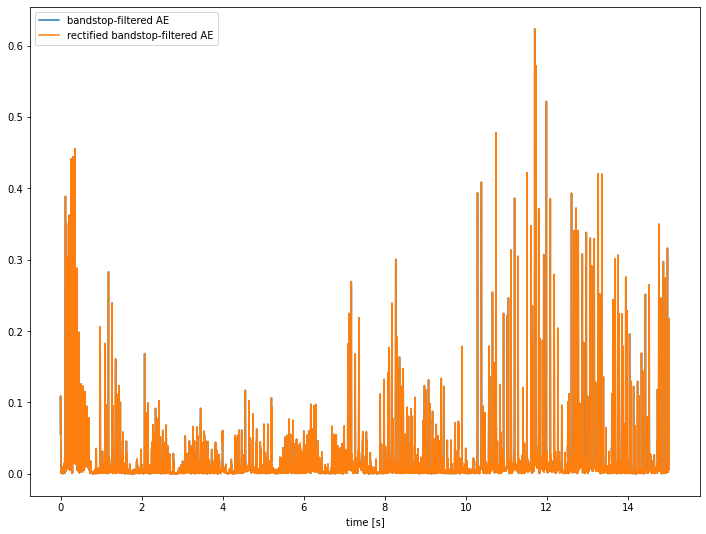

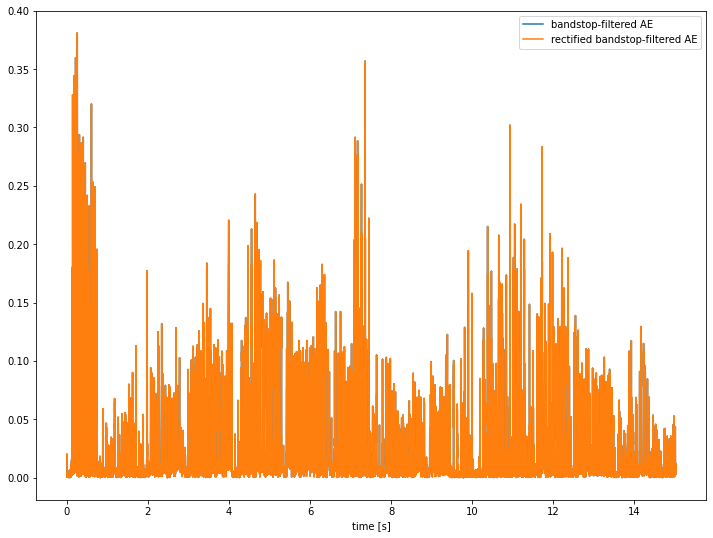

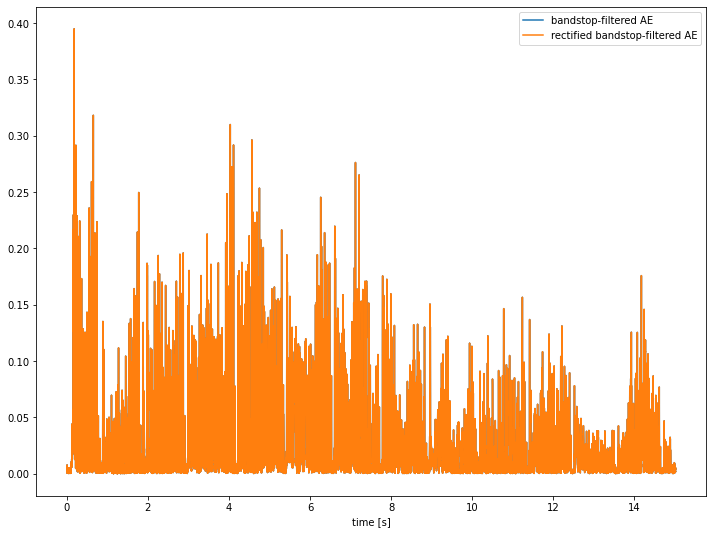

...

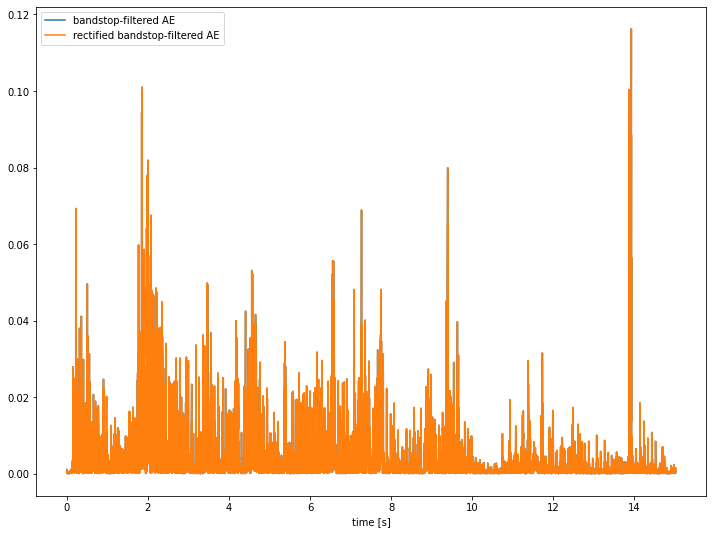

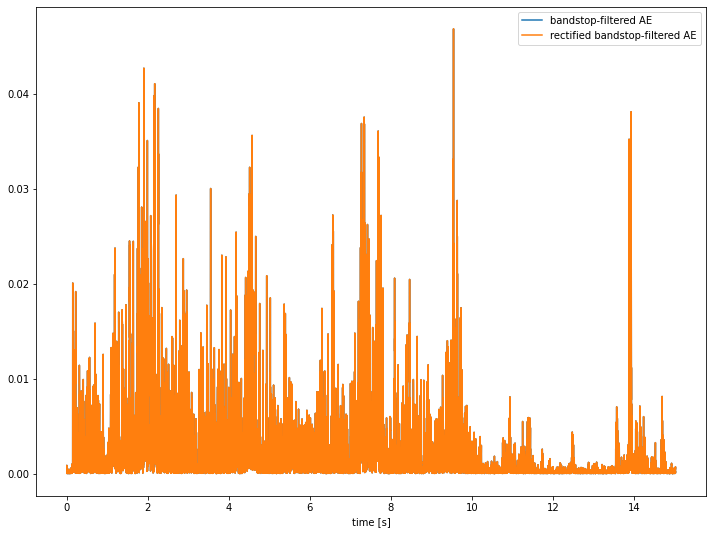

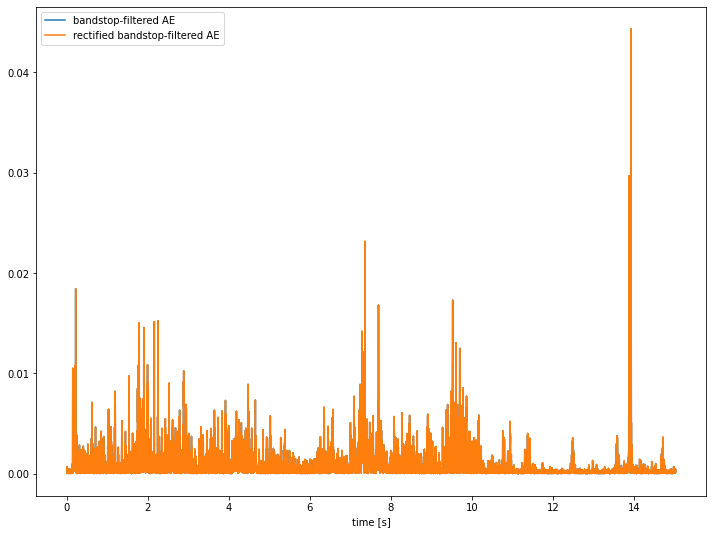

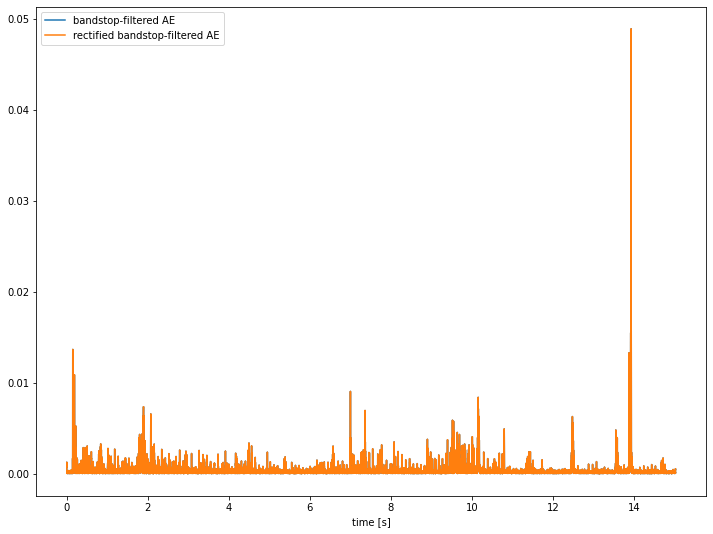

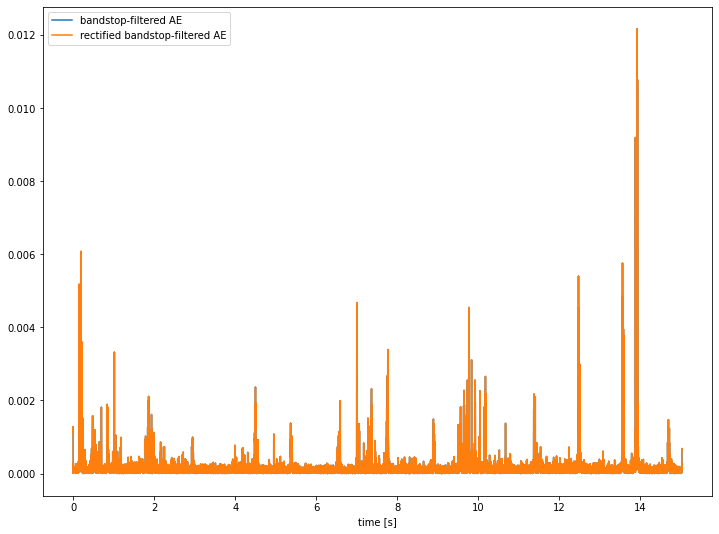

In [ ]:
retrieve_amp_env_rect_P1 = half_rectify(retrieve_amp_env_P1, sr, plots=show_plots)

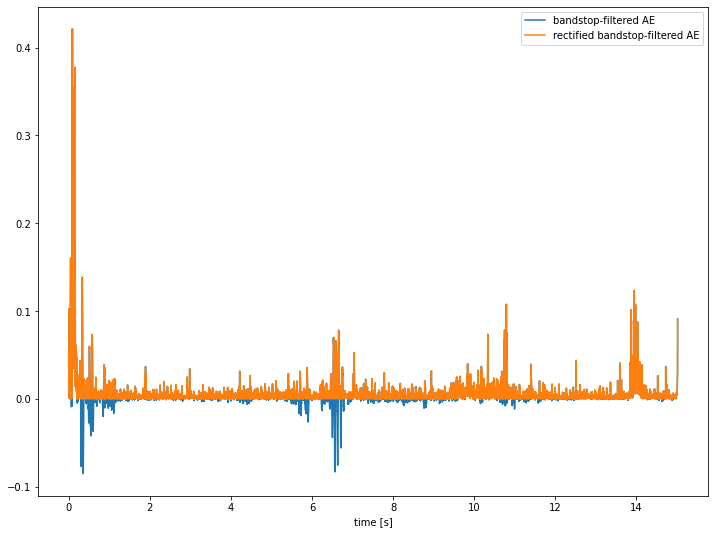

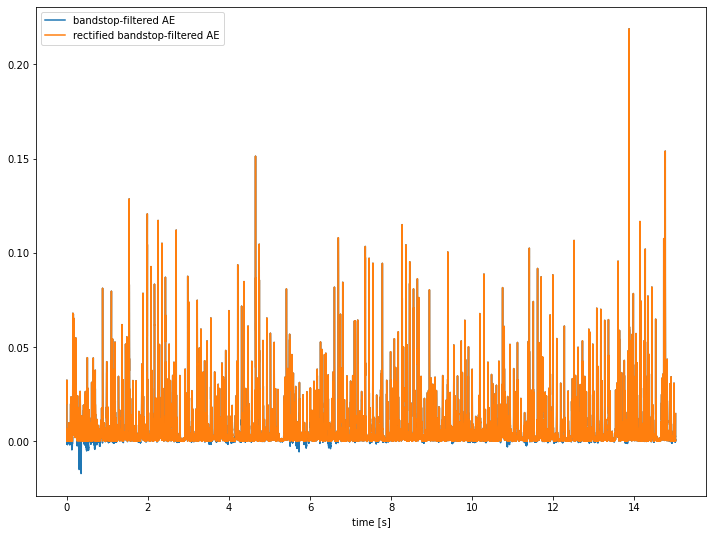

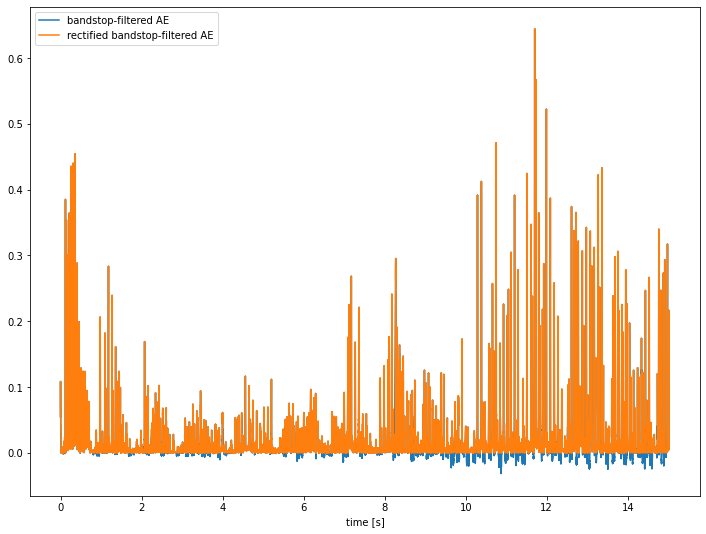

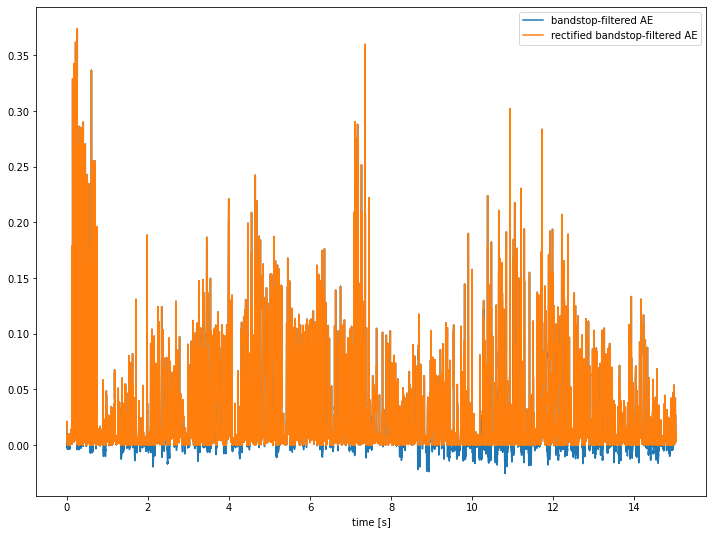

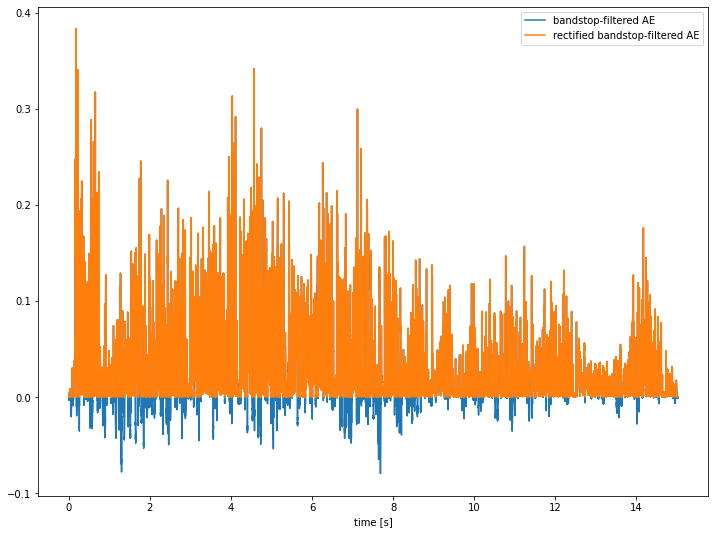

...

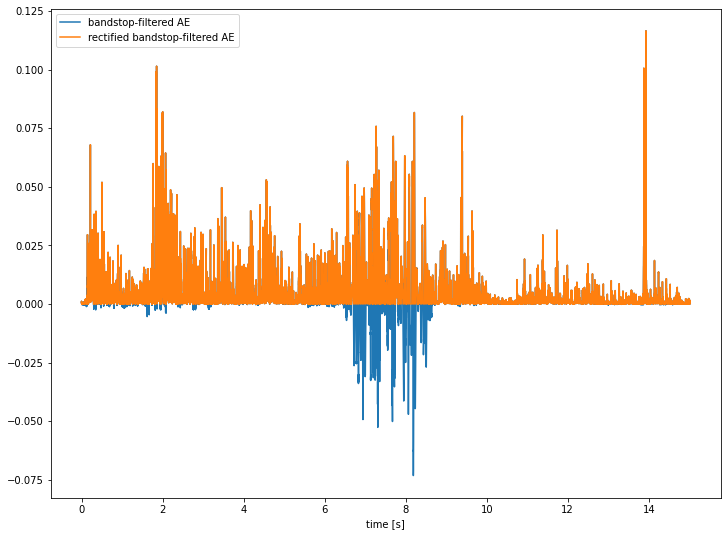

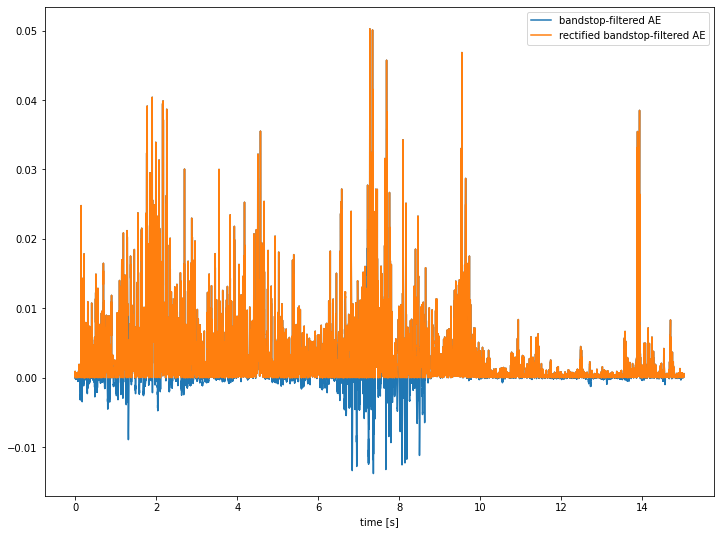

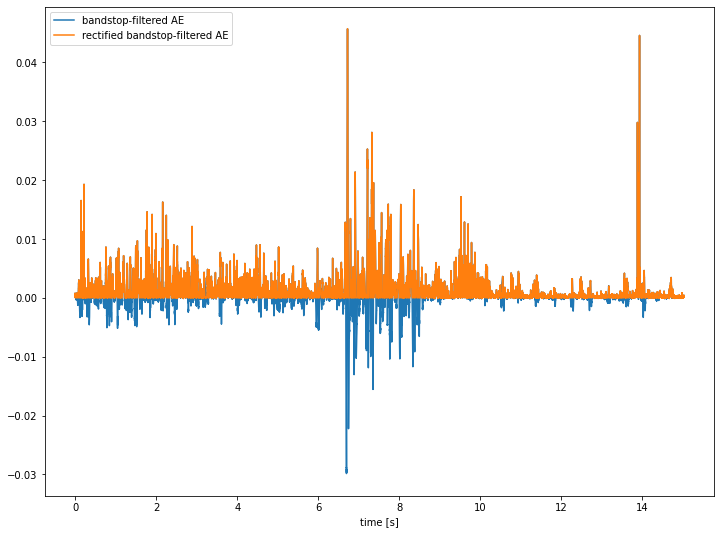

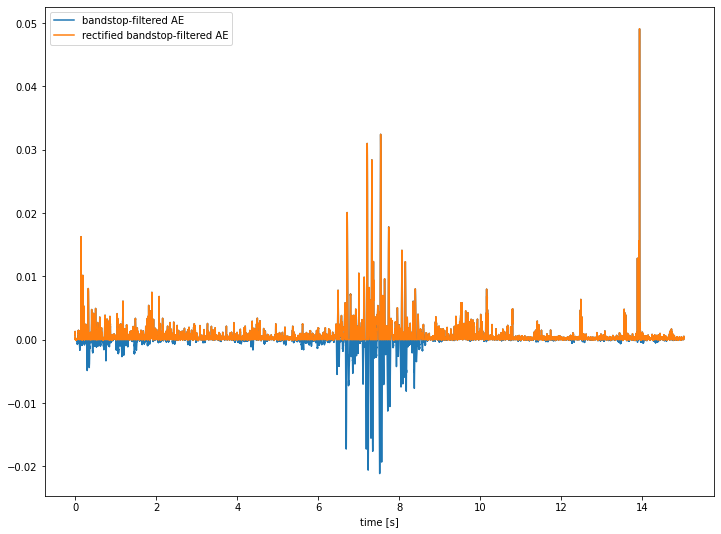

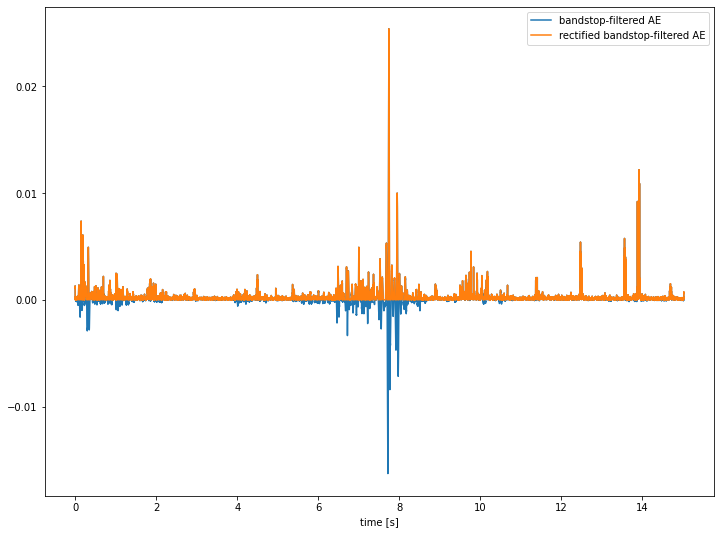

In [ ]:
ia_amp_env_rect_P1 = half_rectify(ia_amp_env_P1, sr, plots=show_plots)

### For Single Host

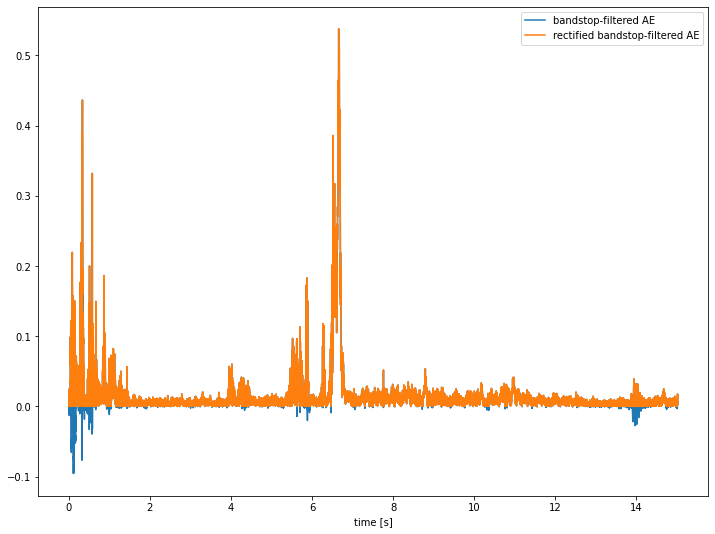

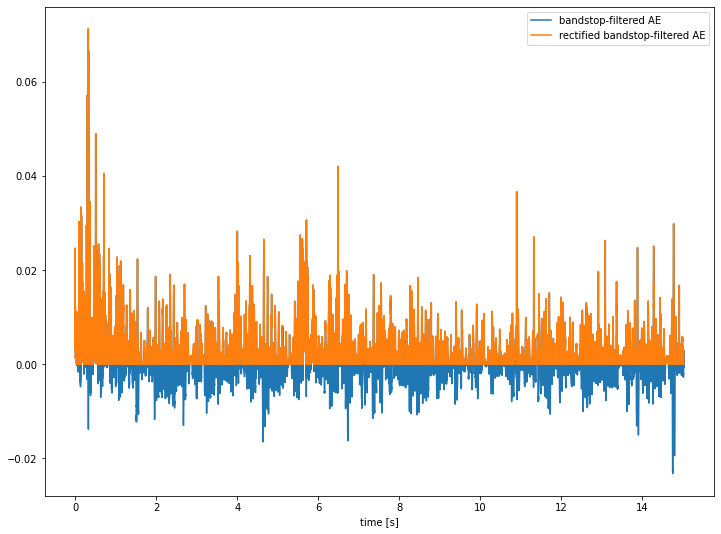

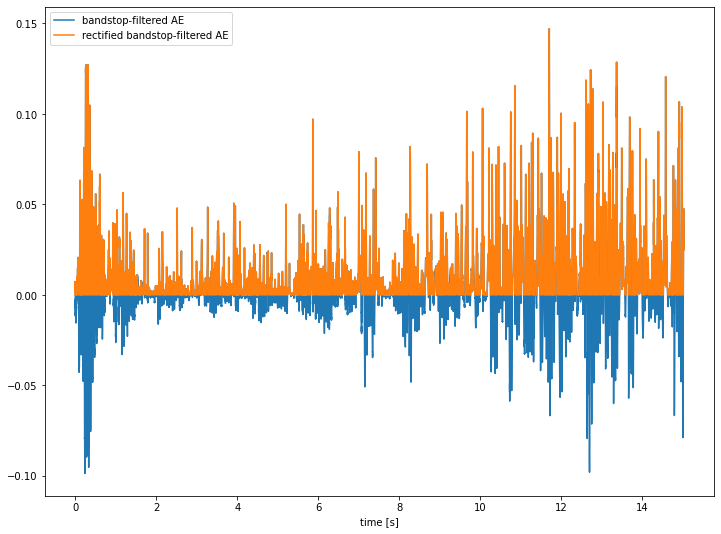

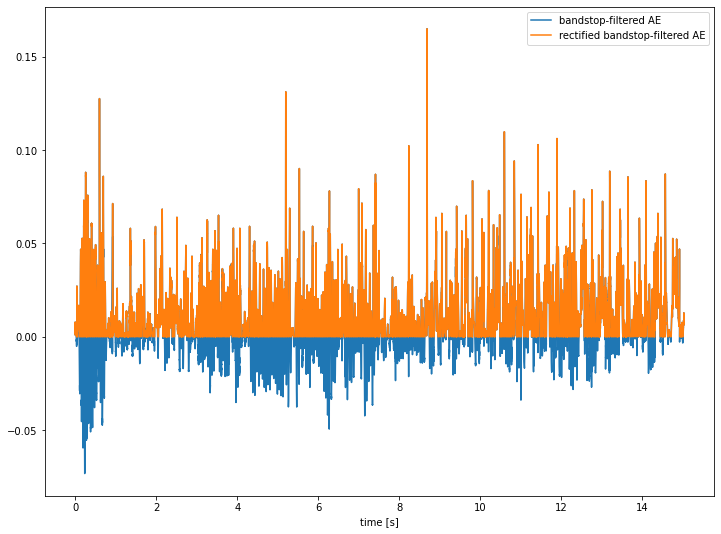

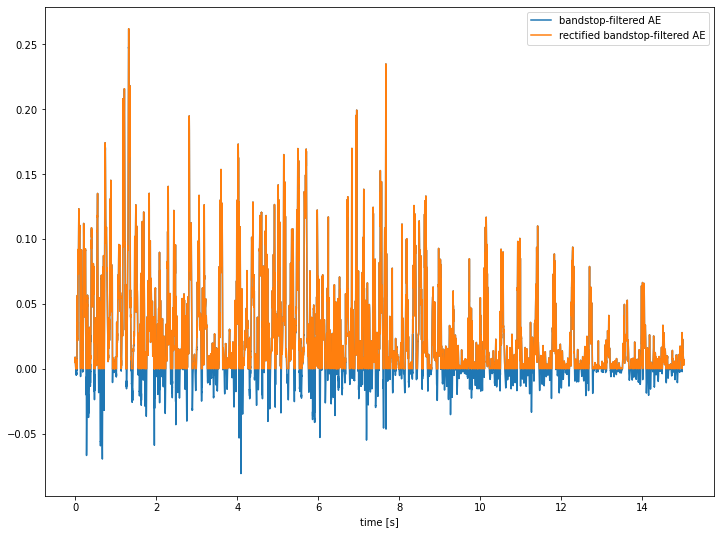

...

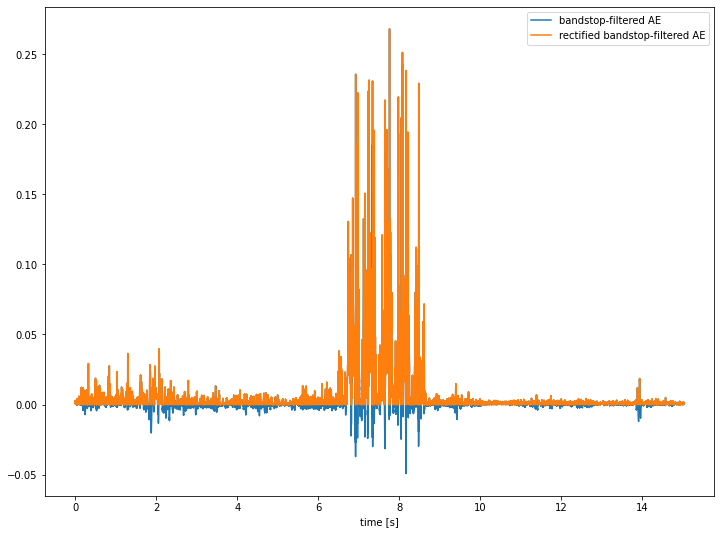

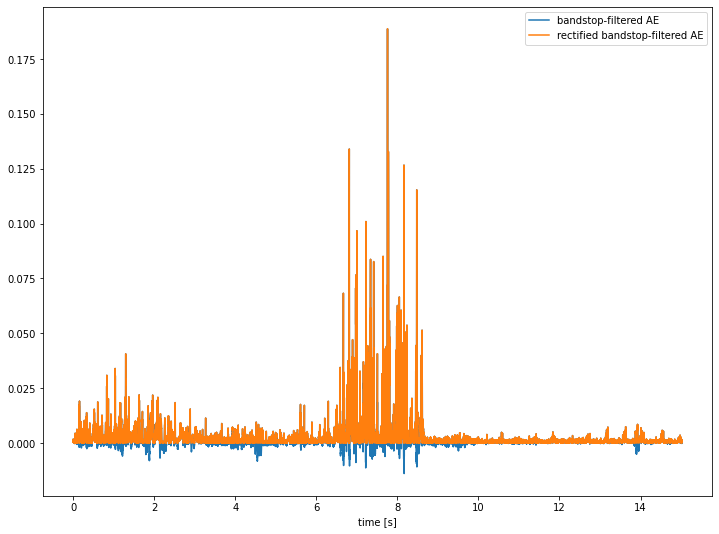

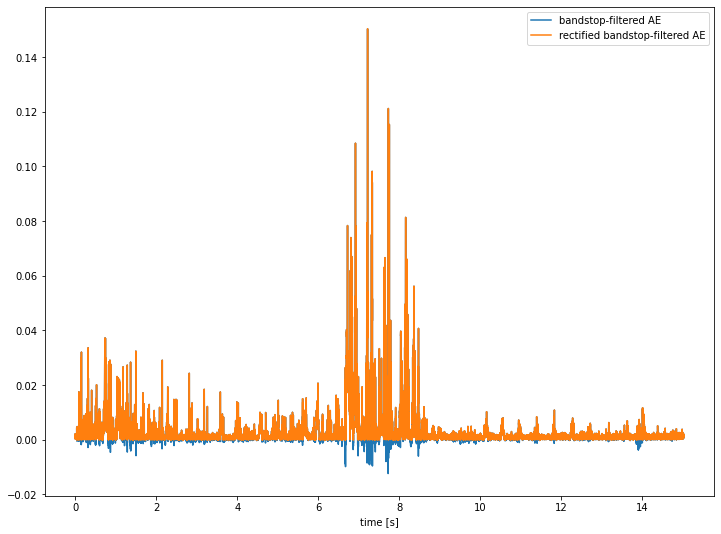

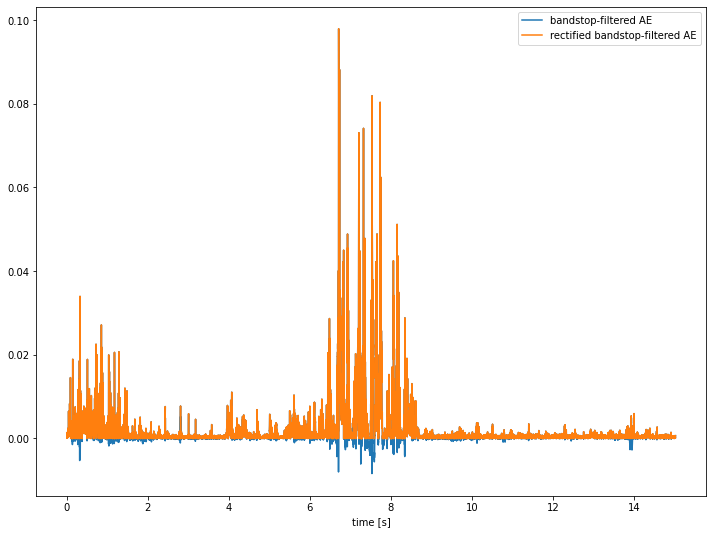

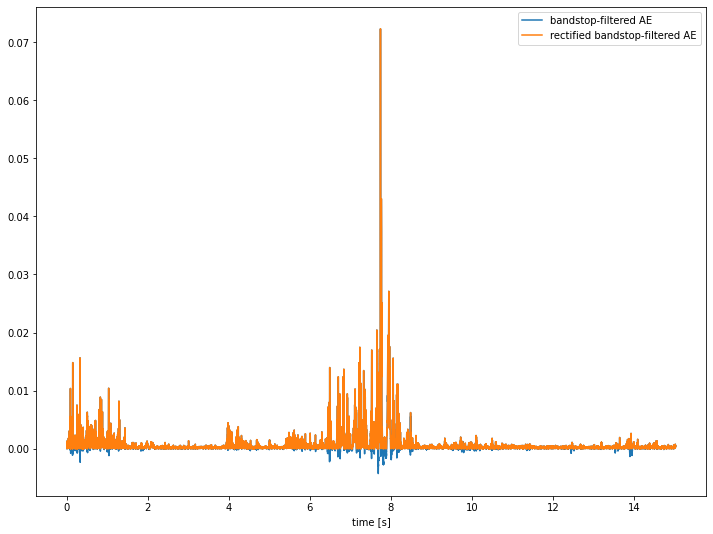

In [ ]:
ir_amp_env_rect_SH1 = half_rectify(ir_amp_env_SH1, sr, plots=show_plots)

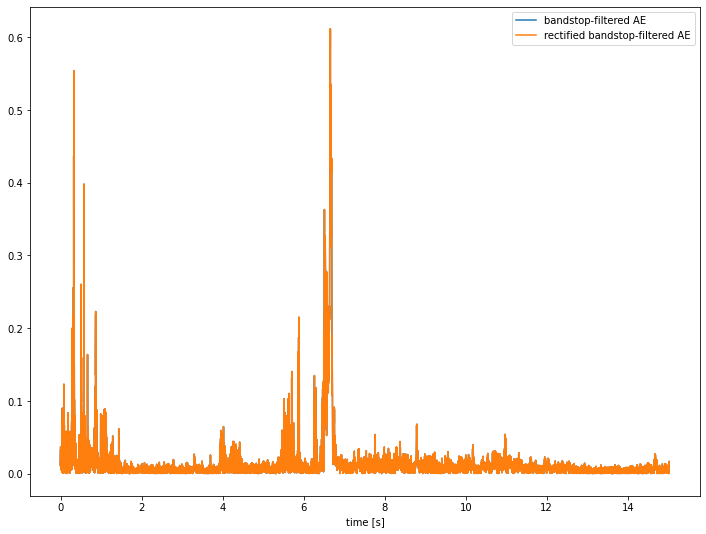

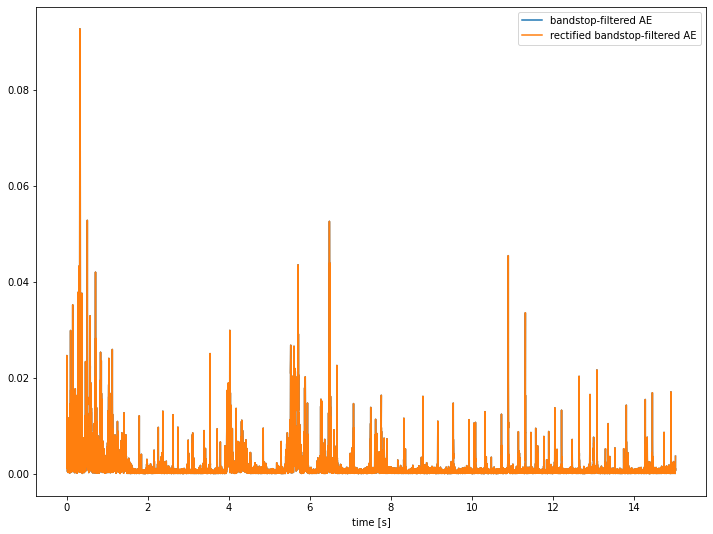

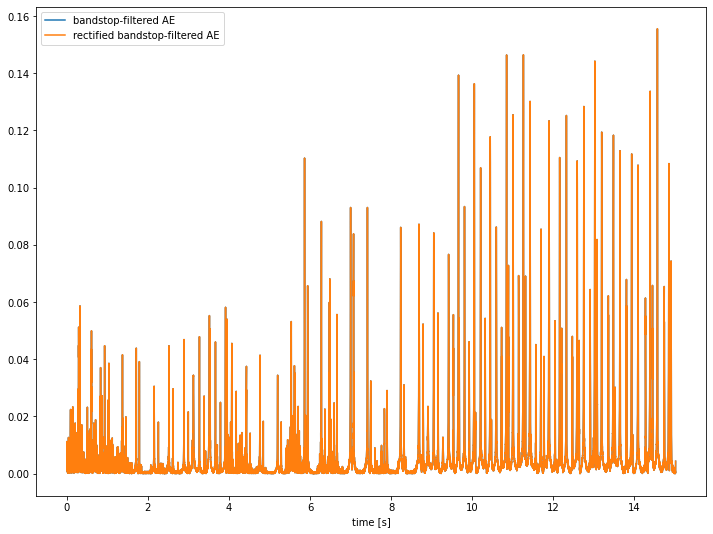

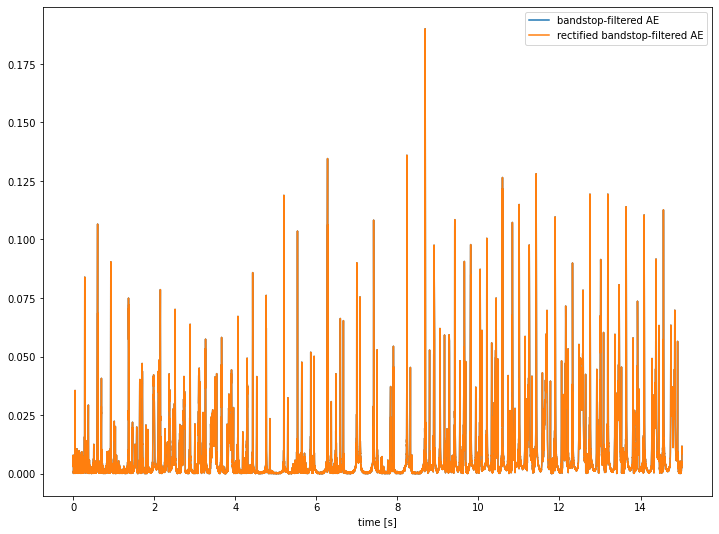

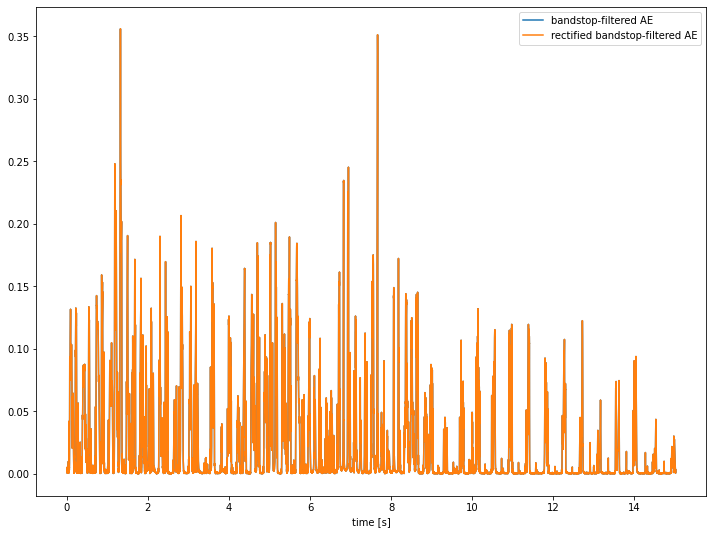

...

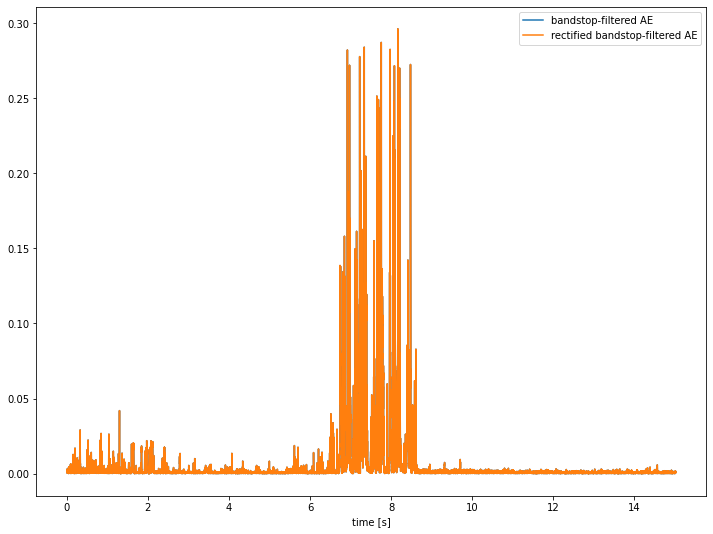

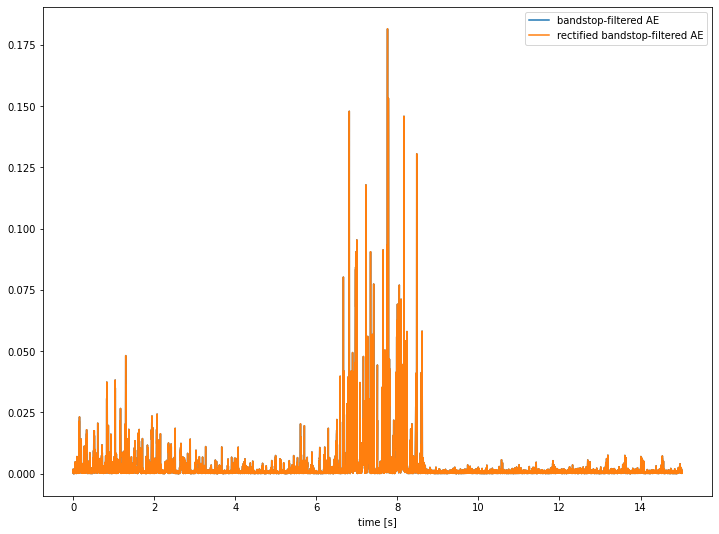

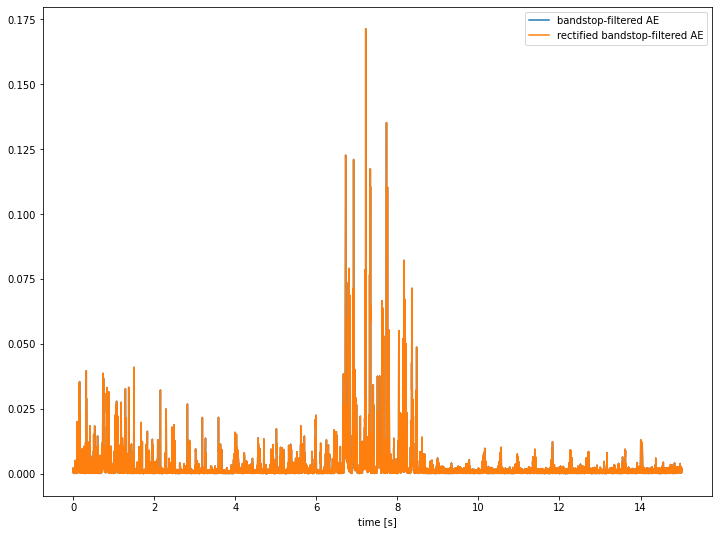

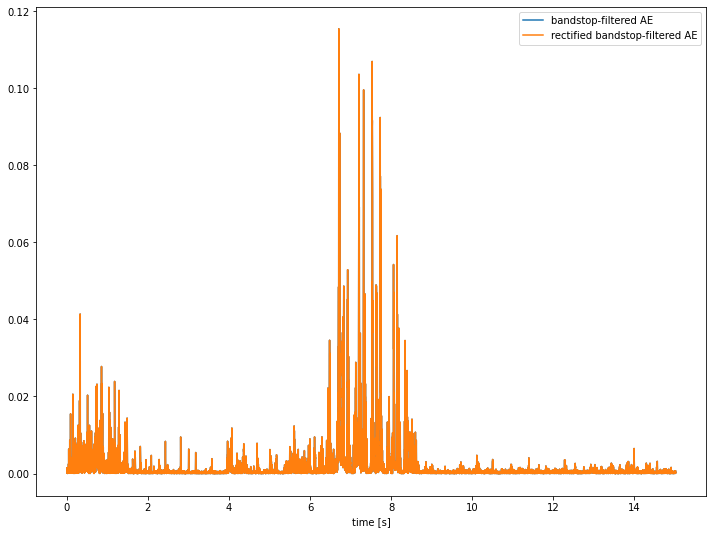

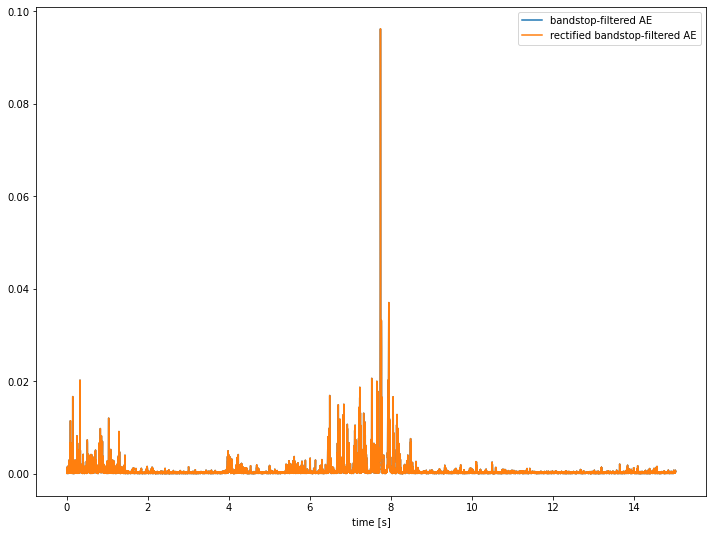

In [ ]:
retrieve_amp_env_rect_SH1 = half_rectify(retrieve_amp_env_SH1, sr, plots=show_plots)

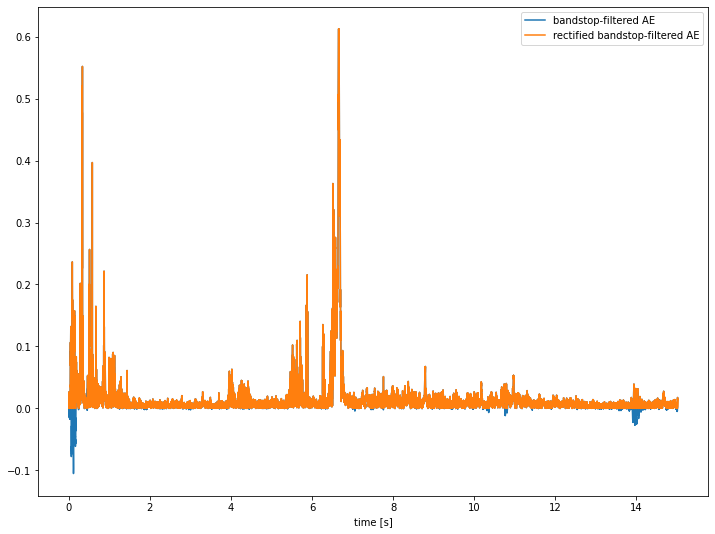

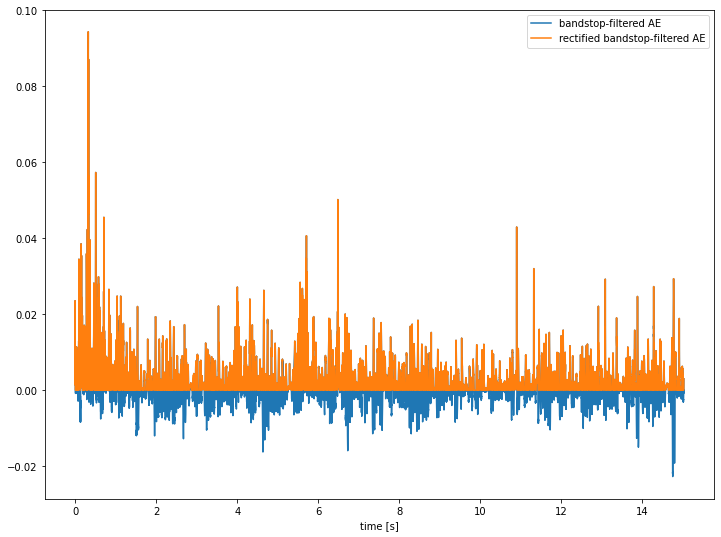

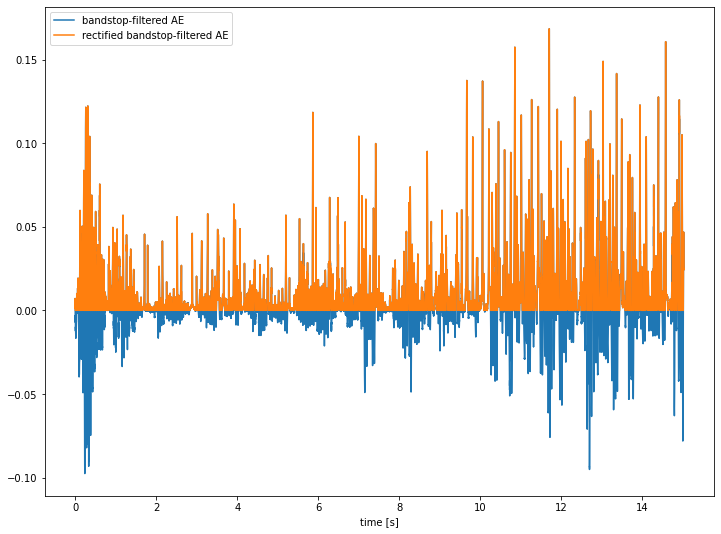

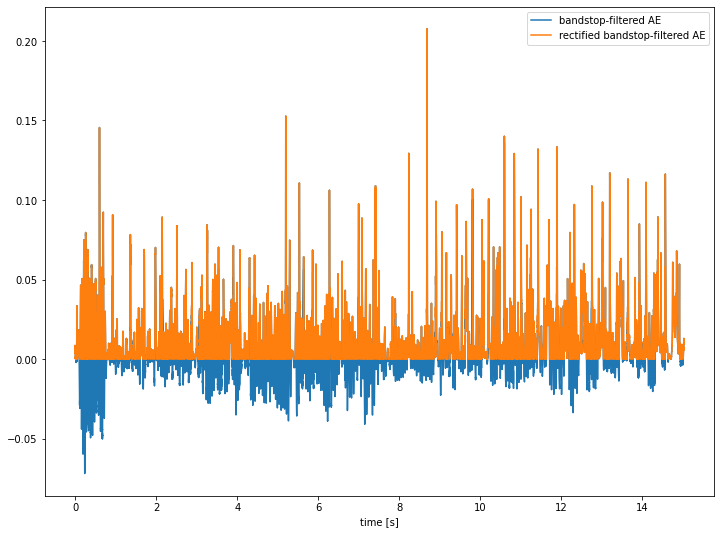

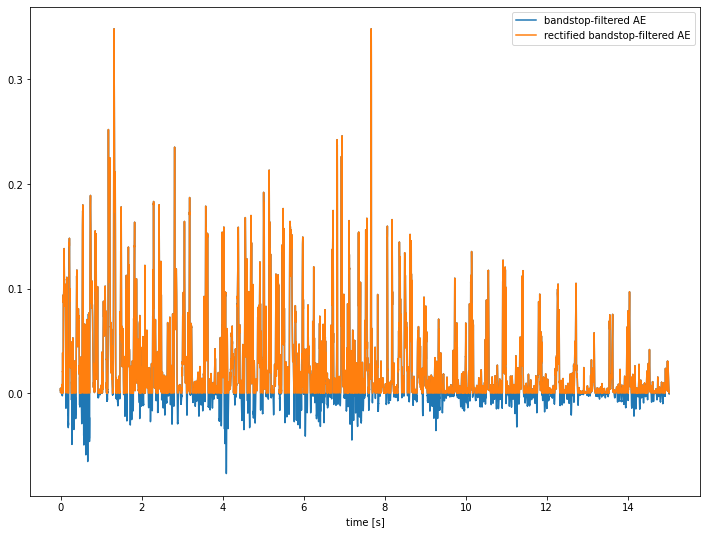

...

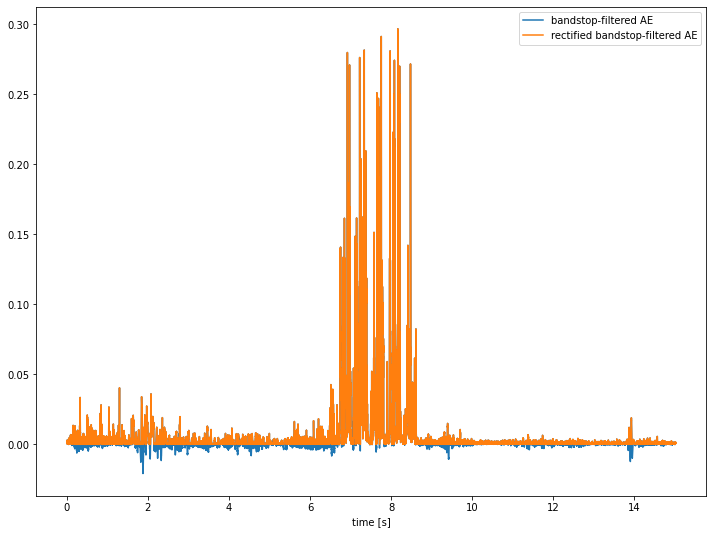

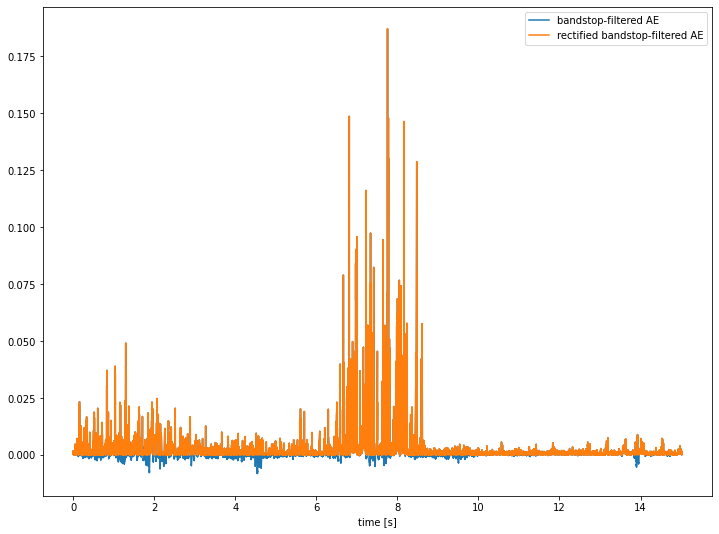

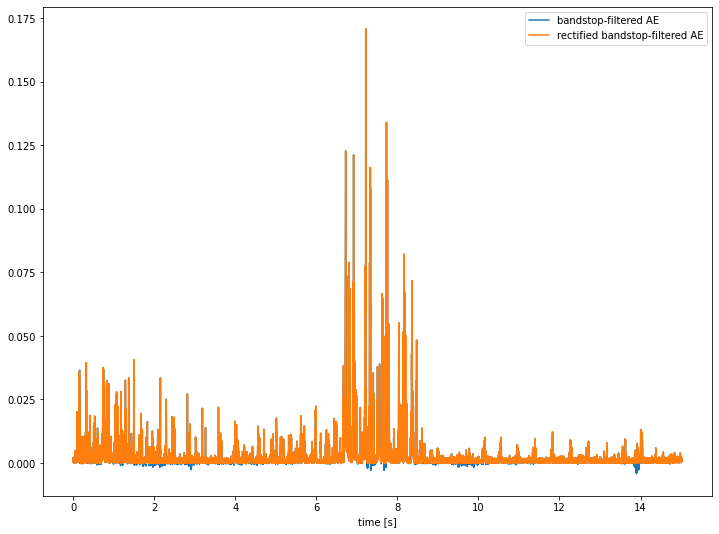

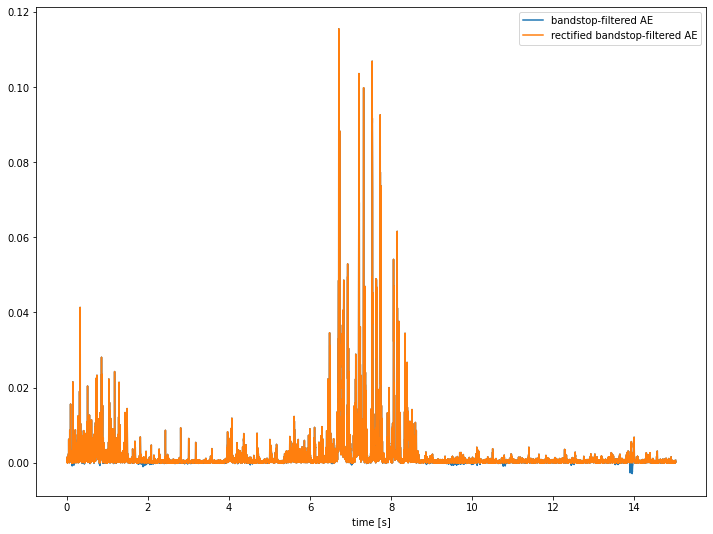

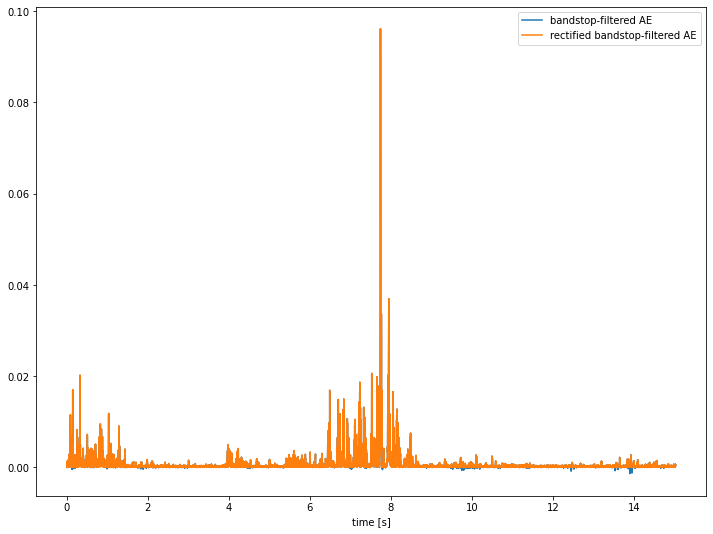

In [ ]:
ia_amp_env_rect_SH1 = half_rectify(ia_amp_env_SH1, sr, plots=show_plots)

# Build modified signals

## for Single Host

### Implant with replacement

In [ ]:
env_IR_SH1 = [i / j for i, j in zip(ir_amp_env_rect_SH1, amp_env_SH1)] # calculate the ratio
IR_bp_signalSH1 = [ i * j for i,j in zip(bp_signalSH1, env_IR_SH1)] # multiply original audio with ratio

IR_signalSH1=sum(IR_bp_signalSH1)


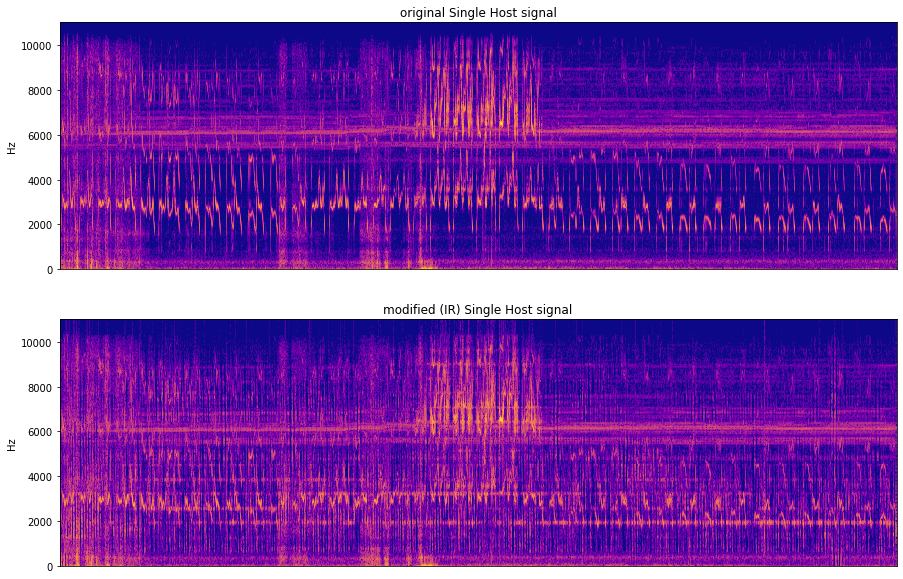

In [ ]:
window_size = 1024
window_shift = 16
fig, ax = plt.subplots(nrows=2, sharex=False,gridspec_kw={'height_ratios': [1, 1]},figsize=(15,10))

#Original  signal

stft = librosa.stft(signalSH1,n_fft=512,hop_length=128)
spec_power = np.abs(stft)**2
p_to_db = librosa.power_to_db(spec_power)

librosa.display.specshow(p_to_db, sr=sr,y_axis='linear',ax = ax[0], cmap='plasma')
ax[0].set_title('original Single Host signal')

#modified  signal

stft = librosa.stft(IR_signalSH1,n_fft=512,hop_length=128)
spec_power = np.abs(stft)**2
p_to_db = librosa.power_to_db(spec_power)

librosa.display.specshow(p_to_db, sr=sr,y_axis='linear',ax = ax[1], cmap='plasma')
ax[1].set_title('modified (IR) Single Host signal')




plt.show()

In [ ]:
print('ORIGINAL SINGLE HOST AUDIO CLIP')

Audio(data=signalSH1,rate=sr)

ORIGINAL SINGLE HOST AUDIO CLIP


In [ ]:
print('MODIFIED  (IR) HOST AUDIO CLIP')

Audio(data=IR_signalSH1,rate=sr)

MODIFIED  (IR) HOST AUDIO CLIP


### Implant with addition

In [ ]:
env_IA_SH1 = [i / j for i, j in zip(ia_amp_env_rect_SH1, amp_env_SH1)] # calculate the ratio
IA_bp_signalSH1 = [ i * j for i,j in zip(bp_signalSH1, env_IA_SH1)] # multiply original audio with ratio

IA_signalSH1=sum(IA_bp_signalSH1)


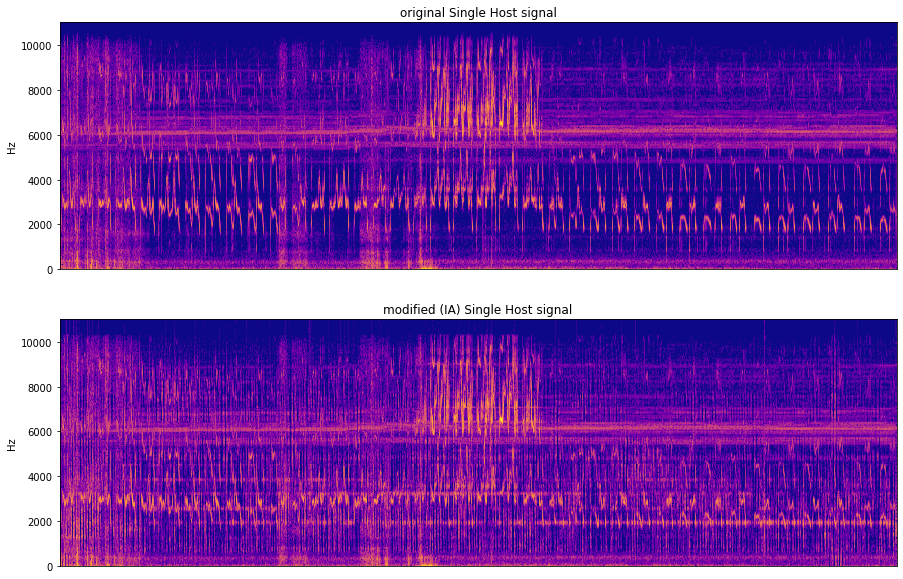

In [ ]:
window_size = 1024
window_shift = 16
fig, ax = plt.subplots(nrows=2, sharex=False,gridspec_kw={'height_ratios': [1, 1]},figsize=(15,10))

#Original  signal

stft = librosa.stft(signalSH1,n_fft=512,hop_length=128)
spec_power = np.abs(stft)**2
p_to_db = librosa.power_to_db(spec_power)

librosa.display.specshow(p_to_db, sr=sr,y_axis='linear',ax = ax[0], cmap='plasma')
ax[0].set_title('original Single Host signal')

#modified  signal

stft = librosa.stft(IA_signalSH1,n_fft=512,hop_length=128)
spec_power = np.abs(stft)**2
p_to_db = librosa.power_to_db(spec_power)

librosa.display.specshow(p_to_db, sr=sr,y_axis='linear',ax = ax[1], cmap='plasma')
ax[1].set_title('modified (IA) Single Host signal')




plt.show()

In [ ]:
print('ORIGINAL SINGLE HOST AUDIO CLIP')

Audio(data=signalSH1,rate=sr)

ORIGINAL SINGLE HOST AUDIO CLIP


In [ ]:
print('MODIFIED (IA) SINGLE HOST AUDIO CLIP')

Audio(data=IA_signalSH1,rate=sr)

MODIFIED (IA) SINGLE HOST AUDIO CLIP


### Retrieval 

In [ ]:
env_retrieve_SH1 = [i / j for i, j in zip(retrieve_amp_env_rect_SH1, amp_env_SH1)] # calculate the ratio
retrieve_bp_signalSH1 = [ i * j for i,j in zip(bp_signalSH1, env_retrieve_SH1)] # multiply original audio with ratio

retrieve_signalSH1=sum(retrieve_bp_signalSH1)


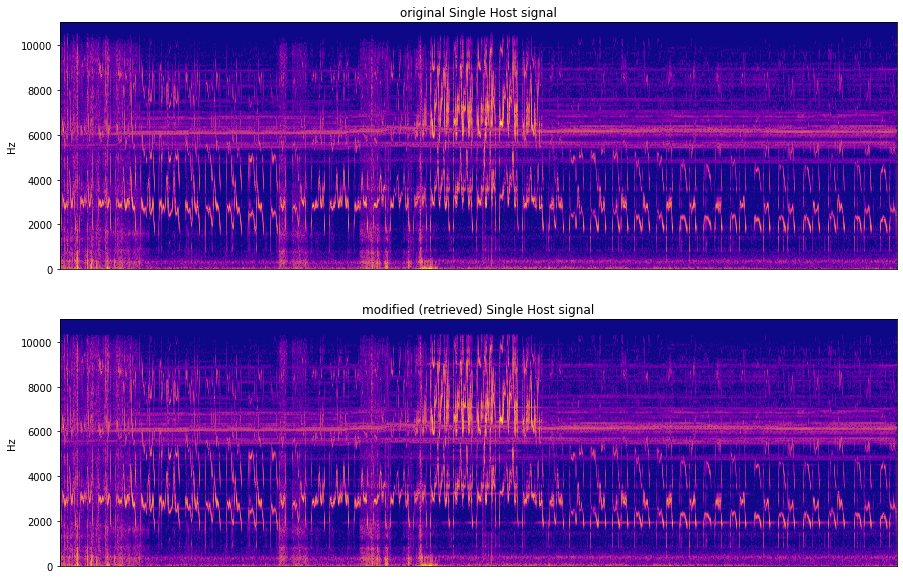

In [ ]:
window_size = 1024
window_shift = 16
fig, ax = plt.subplots(nrows=2, sharex=False,gridspec_kw={'height_ratios': [1, 1]},figsize=(15,10))

#Original  signal

stft = librosa.stft(signalSH1,n_fft=512,hop_length=128)
spec_power = np.abs(stft)**2
p_to_db = librosa.power_to_db(spec_power)

librosa.display.specshow(p_to_db, sr=sr,y_axis='linear',ax = ax[0], cmap='plasma')
ax[0].set_title('original Single Host signal')

#modified  signal

stft = librosa.stft(retrieve_signalSH1,n_fft=512,hop_length=128)
spec_power = np.abs(stft)**2
p_to_db = librosa.power_to_db(spec_power)

librosa.display.specshow(p_to_db, sr=sr,y_axis='linear',ax = ax[1], cmap='plasma')
ax[1].set_title('modified (retrieved) Single Host signal')




plt.show()

In [ ]:
print('ORIGINAL SINGLE HOST AUDIO CLIP')

Audio(data=signalSH1,rate=sr)

ORIGINAL SINGLE HOST AUDIO CLIP


In [ ]:
print('MODIFIED (RETRIEVED) SINGLE HOST AUDIO CLIP')

Audio(data=retrieve_signalSH1,rate=sr)

MODIFIED (RETRIEVED) SINGLE HOST AUDIO CLIP


## For Parasite

### Implant with replacement

In [ ]:
env_IR_P1 = [i / j for i, j in zip(ir_amp_env_rect_P1, amp_env_P1)] # calculate the ratio
IR_bp_signalP1 = [ i * j for i,j in zip(bp_signalP1, env_IR_P1)] # multiply original audio with ratio

IR_signalP1=sum(IR_bp_signalP1)

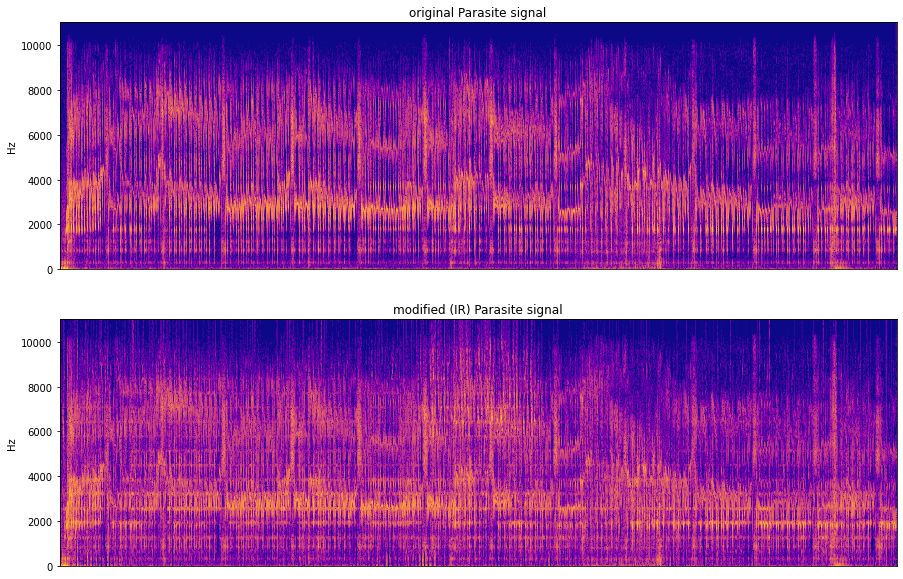

In [ ]:
window_size = 1024
window_shift = 16
fig, ax = plt.subplots(nrows=2, sharex=False,gridspec_kw={'height_ratios': [1, 1]},figsize=(15,10))

#Original  signal

stft = librosa.stft(signalP1,n_fft=512,hop_length=128)
spec_power = np.abs(stft)**2
p_to_db = librosa.power_to_db(spec_power)

librosa.display.specshow(p_to_db, sr=sr,y_axis='linear',ax = ax[0], cmap='plasma')
ax[0].set_title('original Parasite signal')

#modified  signal

stft = librosa.stft(IR_signalP1,n_fft=512,hop_length=128)
spec_power = np.abs(stft)**2
p_to_db = librosa.power_to_db(spec_power)

librosa.display.specshow(p_to_db, sr=sr,y_axis='linear',ax = ax[1], cmap='plasma')
ax[1].set_title('modified (IR) Parasite signal')




plt.show()

In [ ]:
print('ORIGINAL PARASITE AUDIO CLIP')

Audio(data=signalP1,rate=sr)

ORIGINAL PARASITE AUDIO CLIP


In [ ]:
print('MODIFIED (IR) PARASITE AUDIO CLIP')

Audio(data=IR_signalP1,rate=sr)

MODIFIED (IR) PARASITE AUDIO CLIP


### Implant with addition

In [ ]:
env_IA_P1 = [i / j for i, j in zip(ia_amp_env_rect_P1, amp_env_P1)] # calculate the ratio
IA_bp_signalP1 = [ i * j for i,j in zip(bp_signalP1, env_IA_P1)] # multiply original audio with ratio

IA_signalP1=sum(IA_bp_signalP1)


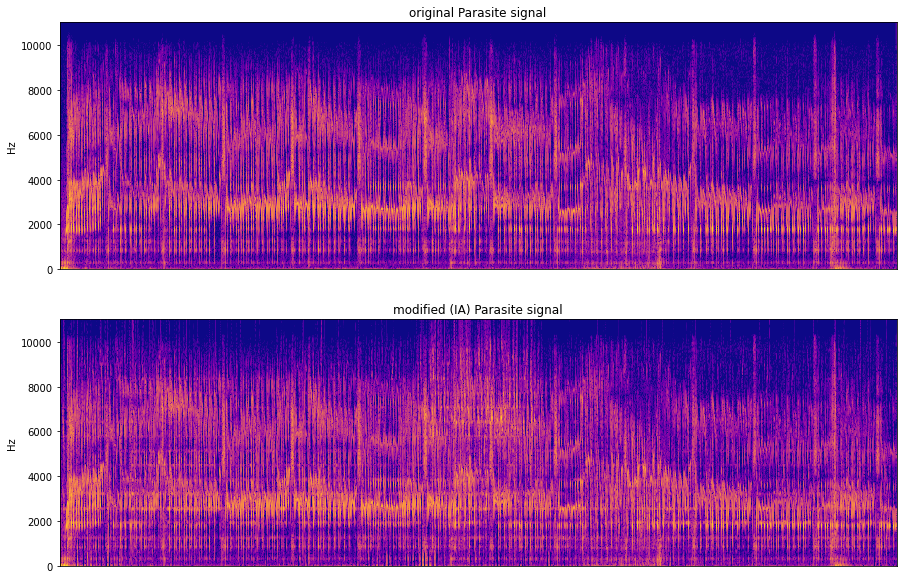

In [ ]:
window_size = 1024
window_shift = 16
fig, ax = plt.subplots(nrows=2, sharex=False,gridspec_kw={'height_ratios': [1, 1]},figsize=(15,10))

#Original  signal

stft = librosa.stft(signalP1,n_fft=512,hop_length=128)
spec_power = np.abs(stft)**2
p_to_db = librosa.power_to_db(spec_power)

librosa.display.specshow(p_to_db, sr=sr,y_axis='linear',ax = ax[0], cmap='plasma')
ax[0].set_title('original Parasite signal')

#modified  signal

stft = librosa.stft(IA_signalP1,n_fft=512,hop_length=128)
spec_power = np.abs(stft)**2
p_to_db = librosa.power_to_db(spec_power)

librosa.display.specshow(p_to_db, sr=sr,y_axis='linear',ax = ax[1], cmap='plasma')
ax[1].set_title('modified (IA) Parasite signal')




plt.show()

In [ ]:
print('ORIGINAL PARASITE AUDIO CLIP')

Audio(data=signalP1,rate=sr)

ORIGINAL PARASITE AUDIO CLIP


In [ ]:
print('MODIFIED (IA) PARASITE AUDIO CLIP')

Audio(data=IA_signalP1,rate=sr)

MODIFIED (IA) PARASITE AUDIO CLIP


### Retrieval 

In [ ]:
env_retrieve_P1 = [i / j for i, j in zip(retrieve_amp_env_rect_P1, amp_env_P1)] # calculate the ratio
retrieve_bp_signalP1 = [ i * j for i,j in zip(bp_signalP1, env_retrieve_P1)] # multiply original audio with ratio

retrieve_signalP1=sum(retrieve_bp_signalP1)


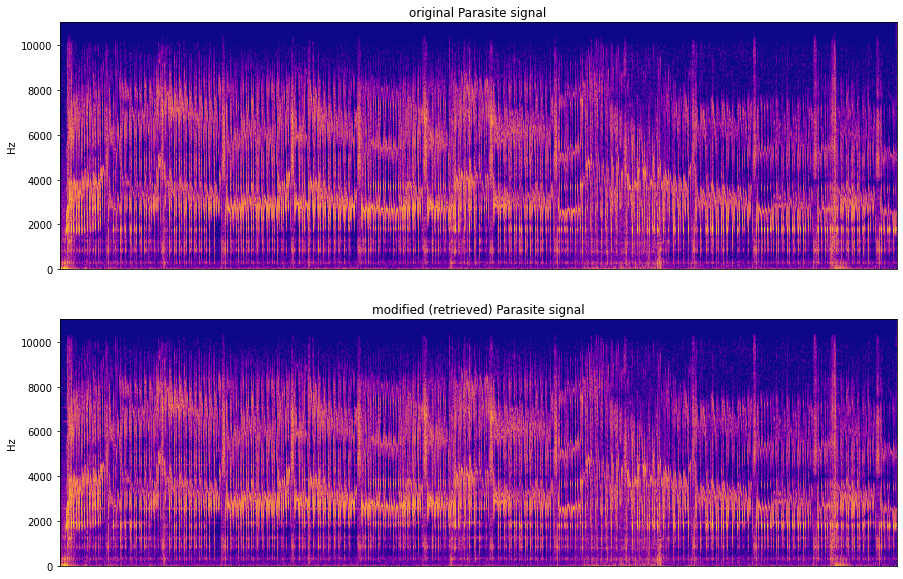

In [ ]:
window_size = 1024
window_shift = 16
fig, ax = plt.subplots(nrows=2, sharex=False,gridspec_kw={'height_ratios': [1, 1]},figsize=(15,10))

#Original  signal

stft = librosa.stft(signalP1,n_fft=512,hop_length=128)
spec_power = np.abs(stft)**2
p_to_db = librosa.power_to_db(spec_power)

librosa.display.specshow(p_to_db, sr=sr,y_axis='linear',ax = ax[0], cmap='plasma')
ax[0].set_title('original Parasite signal')

#modified  signal

stft = librosa.stft(retrieve_signalP1,n_fft=512,hop_length=128)
spec_power = np.abs(stft)**2
p_to_db = librosa.power_to_db(spec_power)

librosa.display.specshow(p_to_db, sr=sr,y_axis='linear',ax = ax[1], cmap='plasma')
ax[1].set_title('modified (retrieved) Parasite signal')




plt.show()

In [ ]:
print('ORIGINAL PARASITE AUDIO CLIP')

Audio(data=signalP1,rate=sr)

ORIGINAL PARASITE AUDIO CLIP


In [ ]:
print('MODIFIED  (RETRIEVED) PARASITE AUDIO CLIP')

Audio(data=retrieve_signalP1,rate=sr)

MODIFIED  (RETRIEVED) PARASITE AUDIO CLIP


## Save audio

In [ ]:
# Give a name for the file to be saved
PinSH_IR = name_P + '_in_' + name_SH + '_implant_with_replacement.wav'
SHinP_IR = name_SH + '_in_' + name_P + '_implant_with_replacement.wav'

PinSH_IA = name_P + '_in_' + name_SH + '_implant_with_addition.wav'
SHinP_IA = name_SH + '_in_' + name_P + '_implant_with_addition.wav'

P_recover = name_P + '_remove_recover.wav'
SH_recover = name_SH + '_remove_recover.wav'



# write file (if in colab, remember to download it before leaving the session)
sf.write(PinSH_IR, IR_signalSH1, sr)

sf.write(SHinP_IR, IR_signalP1, sr)

sf.write(PinSH_IA, IA_signalSH1, sr)

sf.write(SHinP_IA, IA_signalP1, sr)

sf.write(P_recover, retrieve_signalP1, sr)

sf.write(SH_recover, retrieve_signalSH1, sr)